# **Comprehensive Stock Forecasting & Algorithmic Trading Notebook**

**Description:**
This comprehensive notebook provides an end-to-end workflow for stock price forecasting and backtesting. It integrates:
1.  **Robust Data Acquisition** (`yfinance` with caching).
2.  **Advanced Feature Engineering** (Returns, Volatility, Technical Indicators).
3.  **Diverse Forecasting Models:**
    * **Time Series:** ARIMA/SARIMA for mean prediction and GARCH for volatility.
    * **Machine Learning:** XGBoost + LightGBM with **Optuna-based Hyperparameter Tuning**.
    * **Deep Learning:** LSTM (Long Short-Term Memory) for sequence modeling.
4.  **Strategic Backtesting:** A flexible **VectorBT** backtesting framework for evaluating model performance and a simple Momentum Strategy baseline.

**Target Tickers:** `AAPL`, `MSFT`, `GOOGL`, `AMZN`, `META`.

---

## **1. Setup, Imports & Configuration**

**Required Packages:** For full functionality:
```bash
pip install yfinance pandas numpy matplotlib seaborn scikit-learn statsmodels arch tensorflow xgboost optuna vectorbt tqdm
```

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
from pathlib import Path
from tqdm import tqdm
import yfinance as yf
import warnings
import nbformat
import re

%matplotlib inline
plt.rcParams['figure.figsize'] = (14, 7)
sns.set_style('whitegrid')

DATA_DIR = Path('data_forecast')
DATA_DIR.mkdir(exist_ok=True)

try:
    import statsmodels.api as sm
    from statsmodels.tsa.statespace.sarimax import SARIMAX
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    from arch import arch_model
except ImportError: print("statsmodels/arch not installed. Time series models skipped.")

try:
    from sklearn.metrics import mean_squared_error, mean_absolute_error, log_loss, accuracy_score, roc_auc_score
    from sklearn.preprocessing import MinMaxScaler
    import lightgbm as lgb
    import xgboost as xgb
    import optuna
except ImportError: print("XGBoost/Optuna not installed. ML models skipped.")

try:
    import tensorflow as tf
    from tensorflow.keras.models import Sequential
    from tensorflow.keras.layers import LSTM, Dense, Dropout
except ImportError: print("TensorFlow not installed. DL models skipped.")

import vectorbt as vbt

TICKERS = ['AAPL', 'MSFT', 'GOOGL', 'AMZN', 'META']
START_DATE = '2016-01-01'
END_DATE = None
INTERVAL = '1d'
FORECAST_HORIZON = 5 # Number of days to forecast
TEST_SIZE = 0.2 # 20% of data for test set
ROLLING_WINDOW = 252 # 1 year of trading days for walk-forward backtest
OPTUNA_N_TRIALS = 50 # Increase this for better results

print(f'Configuration loaded. Tickers: {TICKERS}')

Configuration loaded. Tickers: ['AAPL', 'MSFT', 'GOOGL', 'AMZN', 'META']


---

## **2. Data Acquisition, Caching and Preprocessing**

A robust function to download and cache data for multiple tickers, ensuring clean `Adj Close` prices for all subsequent analysis.

In [2]:
def download_and_cache_data(tickers=TICKERS, start=START_DATE, end=END_DATE, interval=INTERVAL, data_dir=DATA_DIR):
    """Downloads stock data with yfinance, caches it as CSVs, and returns a dictionary of DataFrames."""
    data = {}
    for t in tqdm(tickers, desc="Downloading/Caching Data"):
        file_path = data_dir / f'{t}_{interval}.csv'

        if file_path.exists():
            # Load from cache
            try:
                df = pd.read_csv(file_path, index_col='Date', parse_dates=True)
                print(f"Loaded {t} from cache. Rows: {len(df)}")
            except Exception as e:
                print(f"Error loading {t} from cache: {e}. Re-downloading.")
                df = pd.DataFrame()
        
        if file_path.exists() and not df.empty:
             data[t] = df.copy()
             continue

        # Download data
        df = yf.download(t, start=start, end=end, interval=interval, progress=False, auto_adjust=False)
        
        if df.empty:
            print(f"Warning: {t} returned empty data.")
            continue
        
        # Clean and save
        df.dropna(inplace=True)
        df['Adj Close'] = df['Adj Close'].astype(float)
        df.to_csv(file_path)
        data[t] = df.copy()
        print(f"Downloaded and saved {t}. Rows: {len(df)}")

    # Select one ticker for the main analysis demonstrations
    if not data:
        raise ValueError("No data successfully downloaded for the specified tickers.")
    global df_main_ticker
    df_main_ticker = data[TICKERS[0]].copy()
    print(f"\nMain Ticker for analysis: {TICKERS[0]}")
    return data

stock_data = download_and_cache_data()
df_main_ticker.head()

Downloading/Caching Data:  20%|██        | 1/5 [00:08<00:32,  8.14s/it]

Downloaded and saved AAPL. Rows: 2491


Downloading/Caching Data:  40%|████      | 2/5 [00:08<00:10,  3.57s/it]

Downloaded and saved MSFT. Rows: 2491


Downloading/Caching Data:  60%|██████    | 3/5 [00:08<00:04,  2.10s/it]

Downloaded and saved GOOGL. Rows: 2491


Downloading/Caching Data:  80%|████████  | 4/5 [00:09<00:01,  1.38s/it]

Downloaded and saved AMZN. Rows: 2491


Downloading/Caching Data: 100%|██████████| 5/5 [00:09<00:00,  1.88s/it]

Downloaded and saved META. Rows: 2491

Main Ticker for analysis: AAPL


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,,
2016-01-04,23.753145,26.337500,26.342501,25.500000,25.652500,270597600
2016-01-05,23.157913,25.677500,26.462500,25.602501,26.437500,223164000
2016-01-06,22.704718,25.174999,25.592501,24.967501,25.139999,273829600
2016-01-07,21.746479,24.112499,25.032499,24.107500,24.670000,324377600
2016-01-08,21.861473,24.240000,24.777500,24.190001,24.637501,283192000


---

## **3. Feature Engineering and Technical Indicators**

We calculate essential features including returns, volatility, and key technical indicators.

**Note on RSI improvement:** The original RSI calculation was complex and error-prone. We use a simpler, more robust pandas-based approach here for stability.

In [3]:
def calculate_technical_features(df):
    """Calculates returns, log-returns, and several key technical indicators."""
    df = df.copy()
    adj_close = df['Adj Close']

    # Returns
    df['return'] = adj_close.pct_change()
    df['log_return'] = np.log(adj_close).diff() # Primary series for ARIMA/GARCH

    # Moving Averages
    df['ma_20'] = adj_close.rolling(window=20).mean()
    df['ma_50'] = adj_close.rolling(window=50).mean()

    # Volatility (Annualized)
    df['vol_20'] = df['log_return'].rolling(window=20).std() * np.sqrt(252)

    # Relative Strength Index (RSI) - Improved/Standard Calculation
    delta = adj_close.diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    avg_gain = gain.rolling(window=14).mean()
    avg_loss = loss.rolling(window=14).mean()
    rs = avg_gain / avg_loss
    df['rsi_14'] = 100 - (100 / (1 + rs))

    # Lagged features for ML/DL models (predicting T+1 Close)
    for i in range(1, FORECAST_HORIZON + 1):
        df[f'Lag_{i}'] = adj_close.shift(i)

    # Target variable (T+1 Close Price) - Used for Regression/LSTM
    df['Target_Close'] = adj_close.shift(-1) 
    
    # Classification Target (Predicts Direction)
    # 1 if tomorrow's Adj Close > Today's Adj Close
    df['Target_Signal'] = (adj_close.shift(-1) > adj_close).astype(int)

    df.dropna(inplace=True)
    return df

df_features_dict = {}
for ticker, df in tqdm(stock_data.items(), desc="Feature Engineering"):
    df_features_dict[ticker] = calculate_technical_features(df)

df_features_all = pd.concat(
    df_features_dict.values(), 
    keys=df_features_dict.keys(), 
    names=['Ticker', 'Date']
)

print(f"\nFeatures calculated for: {list(df_features_dict.keys())}")

df_features_all.loc[pd.IndexSlice[['MSFT'], :], 
                    ['Adj Close', 'Target_Close', 'Target_Signal', 'log_return', 'rsi_14', 'vol_20']].tail(10)

Feature Engineering: 100%|██████████| 5/5 [00:00<00:00, 32.27it/s]


Features calculated for: ['AAPL', 'MSFT', 'GOOGL', 'AMZN', 'META']


Price             Adj Close                             Target_Close  \
Ticker                 AAPL        MSFT GOOGL AMZN META                
Ticker Date                                                            
MSFT   2025-11-12       NaN  510.185150   NaN  NaN  NaN   502.349792   
       2025-11-13       NaN  502.349792   NaN  NaN  NaN   509.226898   
       2025-11-14       NaN  509.226898   NaN  NaN  NaN   506.541931   
       2025-11-17       NaN  506.541931   NaN  NaN  NaN   492.867554   
       2025-11-18       NaN  492.867554   NaN  NaN  NaN   486.209991   
       2025-11-19       NaN  486.209991   NaN  NaN  NaN   478.429993   
       2025-11-20       NaN  478.429993   NaN  NaN  NaN   472.119995   
       2025-11-21       NaN  472.119995   NaN  NaN  NaN   474.000000   
       2025-11-24       NaN  474.000000   NaN  NaN  NaN   476.989990   
       2025-11-25       NaN  476.989990   NaN  NaN  NaN   485.500000   

Price             Target_Signal log_return     rsi_14    vol_20  
Ticker                                                           
Ticker Date                                                      
MSFT   2025-11-12             0   0.004824  44.190946  0.195022  
       2025-11-13             1  -0.015477  38.169551  0.202184  
       2025-11-14             0   0.013597  37.426315  0.208047  
       2025-11-17             0  -0.005287  27.545441  0.207244  
       2025-11-18             0  -0.027367  23.519629  0.227126  
       2025-11-19             0  -0.013600  26.165797  0.228450  
       2025-11-20             0  -0.016131  26.216079  0.232473  
       2025-11-21             1  -0.013277  24.535436  0.231504  
       2025-11-24             1   0.003974  26.968986  0.221936  
       2025-11-25             1   0.006288  32.028676  0.206255

In [4]:
def prepare_splits(df):
    NON_FEATURE_COLS = ['return', 'log_return', 'Target_Close', 'Adj Close', 'High', 'Low', 'Open', 'Close', 'Volume']

    X_cols = [
        col for col in df.columns 
        if isinstance(col, str) and
           col not in NON_FEATURE_COLS and 
           not col.startswith('Target_')
    ]
    
    X = df[X_cols].copy()
    y = df['Target_Signal'].copy()
    
    test_start_index = int(len(df) * (1 - TEST_SIZE))
    
    X_train, X_test = X.iloc[:test_start_index], X.iloc[test_start_index:]
    y_train, y_test = y.iloc[:test_start_index], y.iloc[test_start_index:]
    
    return {
        'X_train': X_train,
        'X_test': X_test,
        'y_train': y_train,
        'y_test': y_test,
        'df_full': df # Keep full DF for easy re-slicing of regression target in XGBoost cell
    }

data_splits_dict = {}
for ticker, df in tqdm(df_features_dict.items(), desc="Splitting Data"):
    data_splits_dict[ticker] = prepare_splits(df)

print(f"\nData splits prepared for: {list(data_splits_dict.keys())}")
print(f"AAPL Training set size: {len(data_splits_dict['AAPL']['X_train'])}")

Splitting Data: 100%|██████████| 5/5 [00:00<00:00, 194.29it/s]


Data splits prepared for: ['AAPL', 'MSFT', 'GOOGL', 'AMZN', 'META']
AAPL Training set size: 1952


---

## **4. Exploratory Data Analysis (EDA) and Diagnostics**

Visualizing the price series, returns, and performing **stationarity diagnostics** on the log-returns which are crucial for time-series modeling (ARIMA/GARCH).

Generating Price and Returns plots...


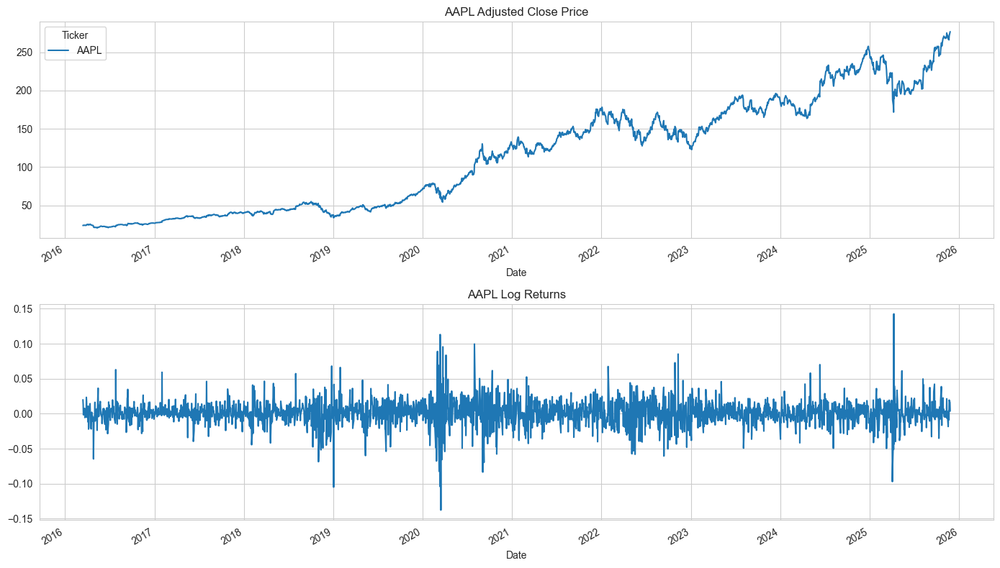

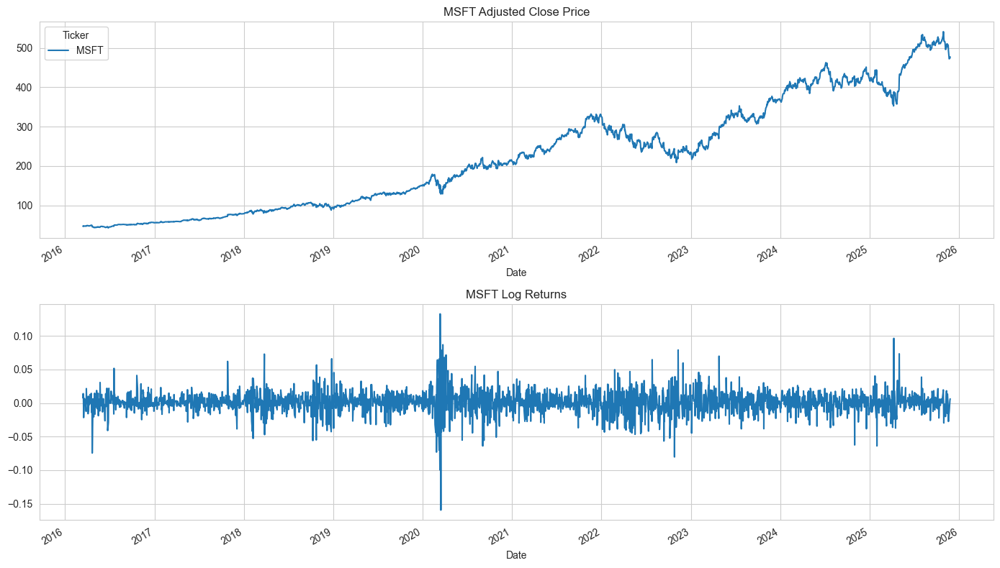

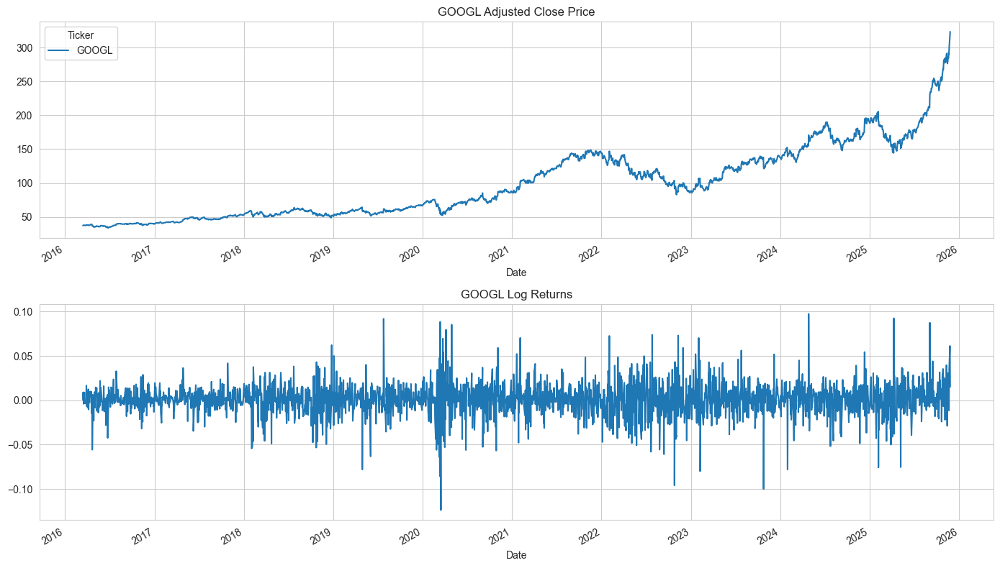

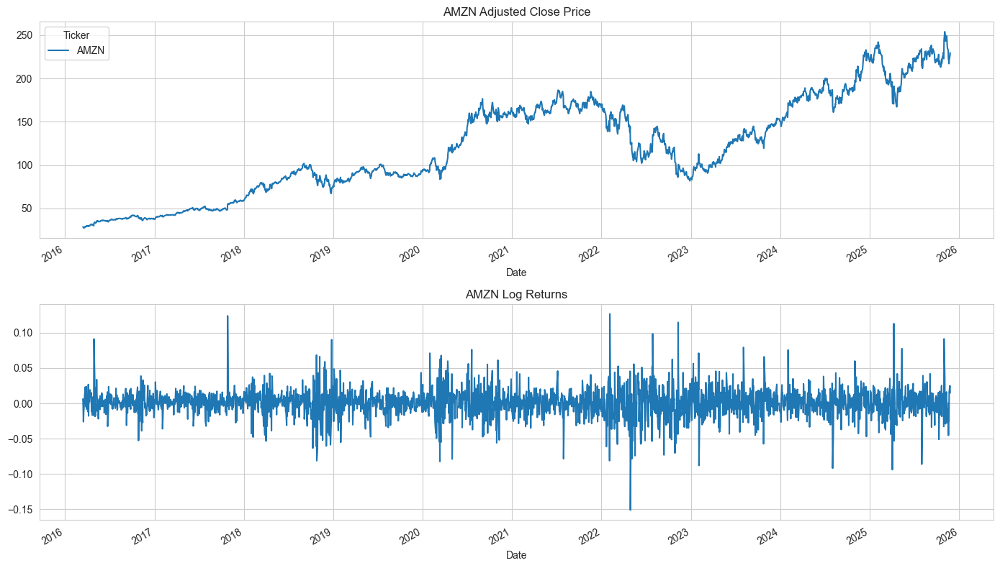

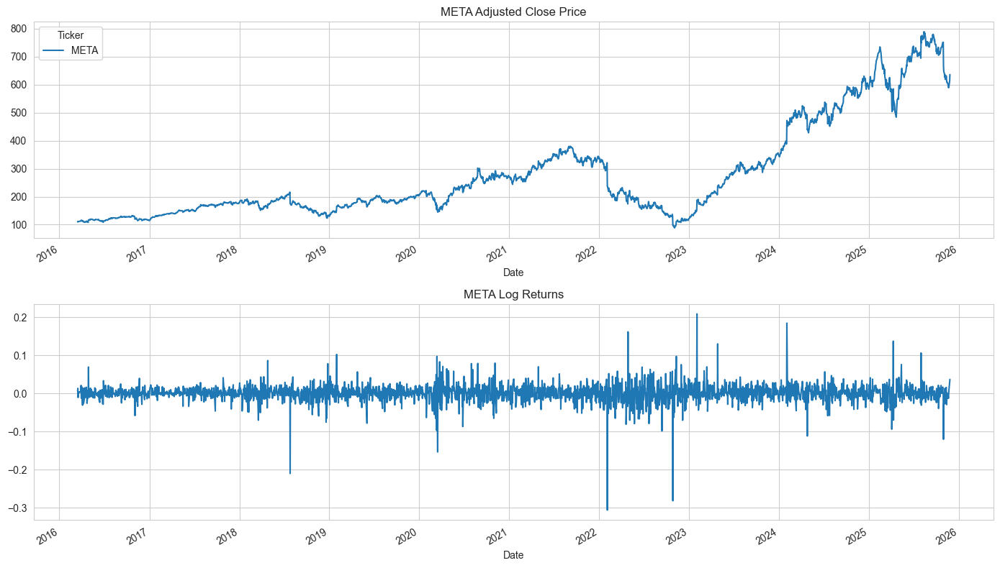

Generating ACF and PACF plots...


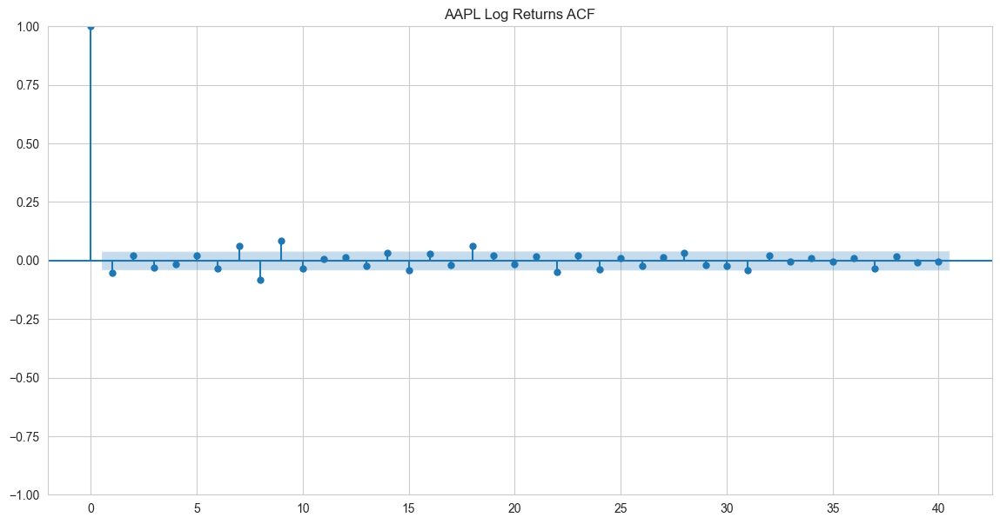

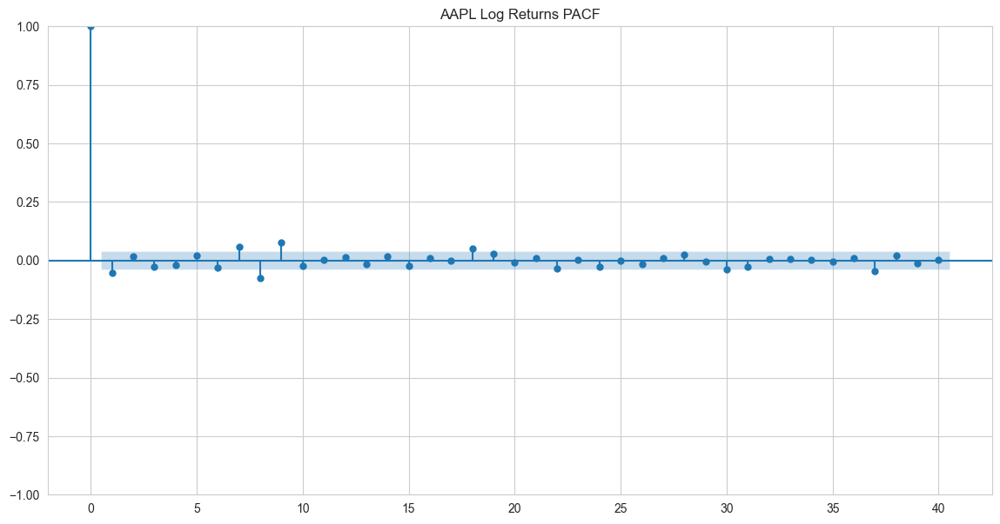

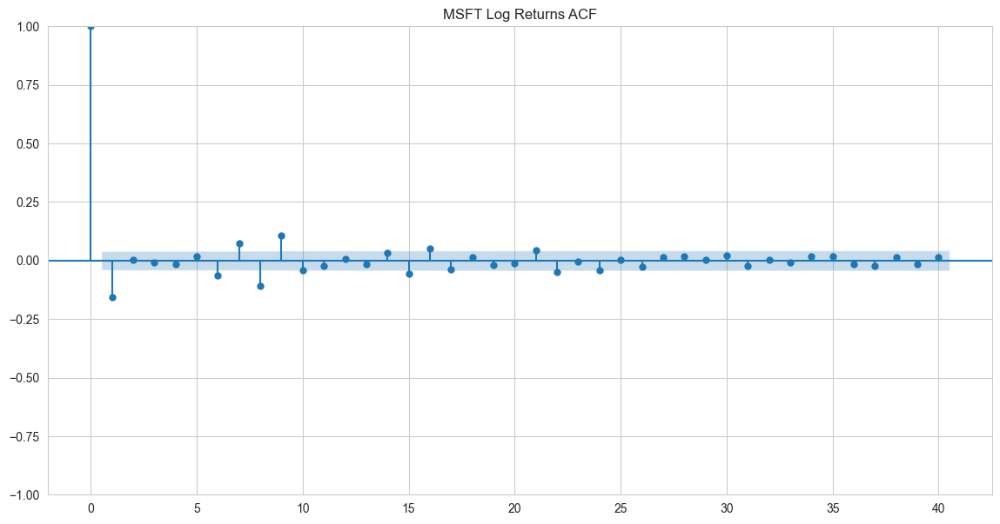

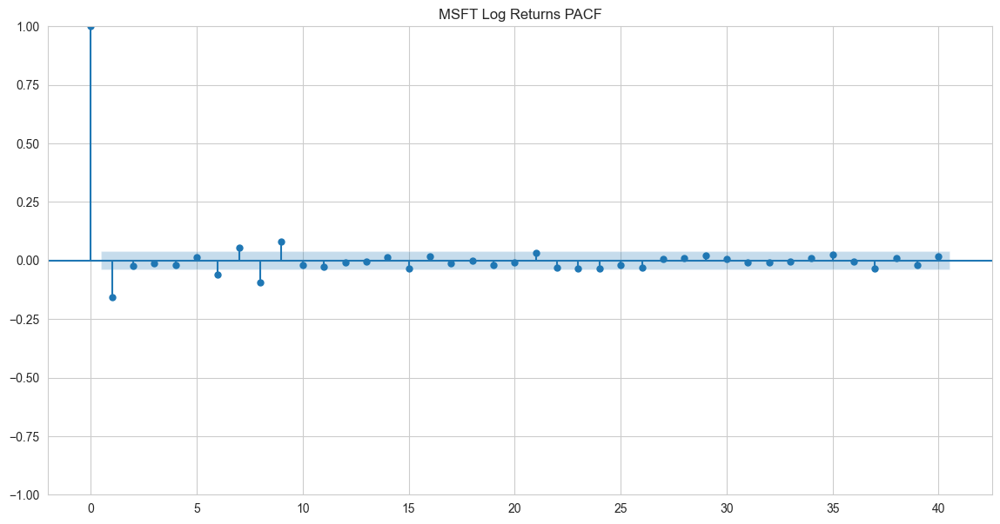

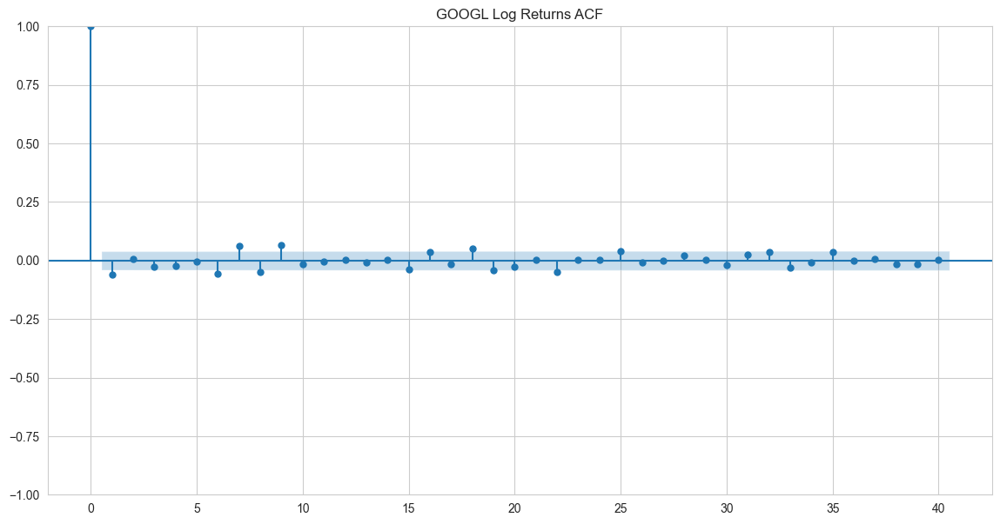

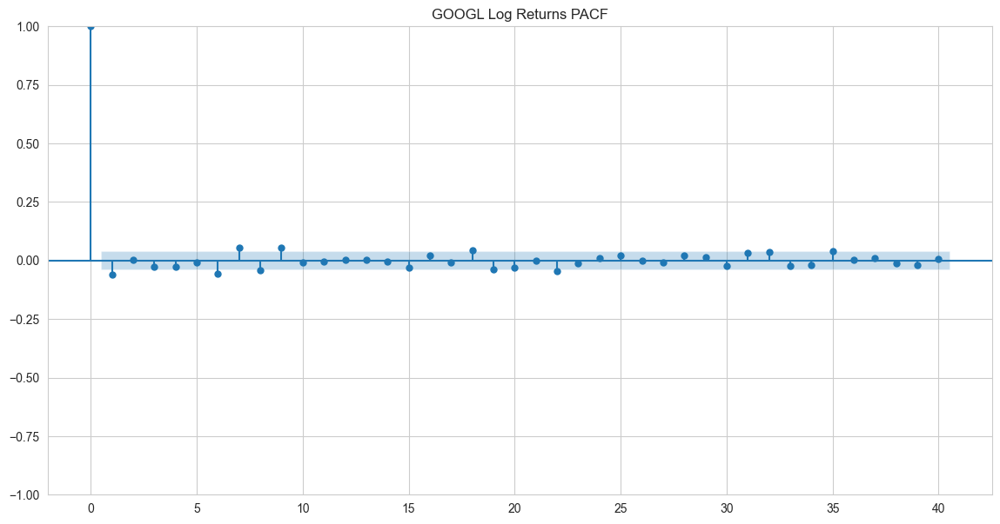

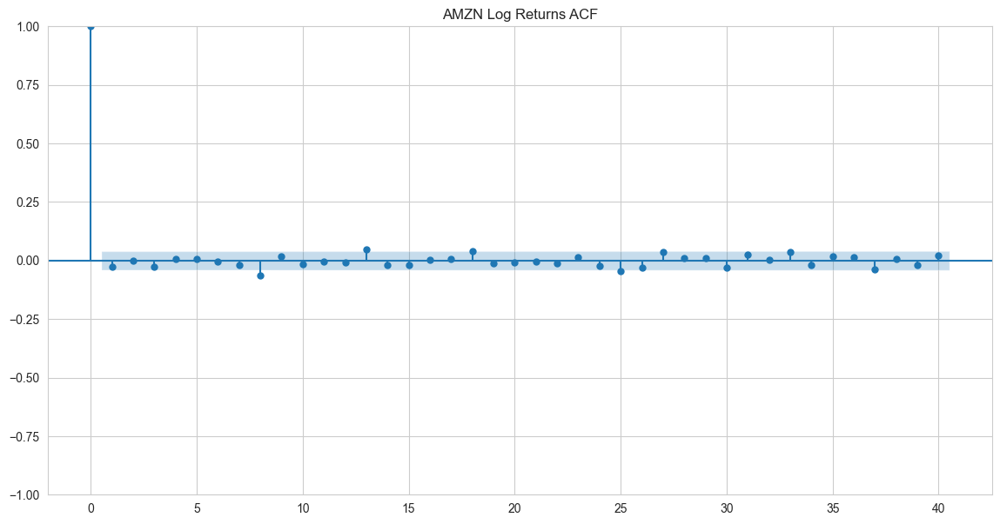

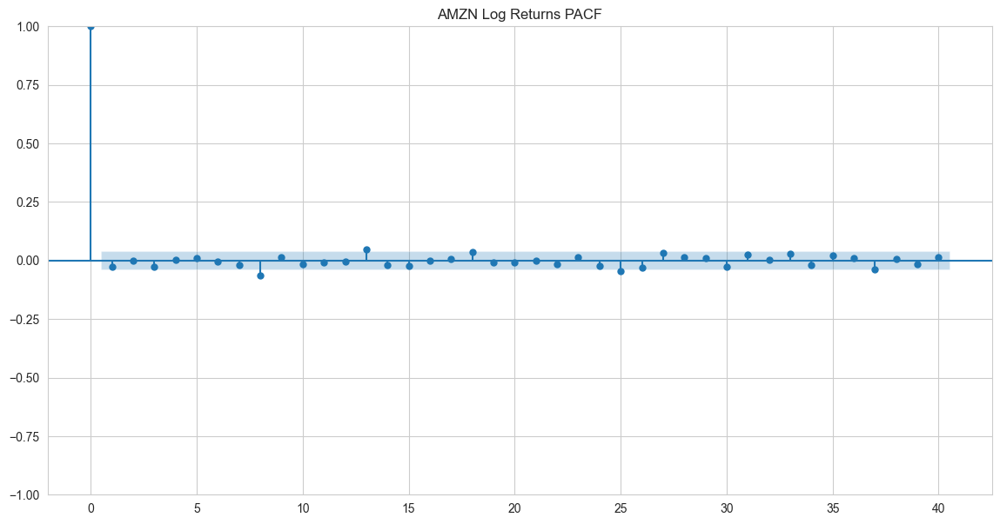

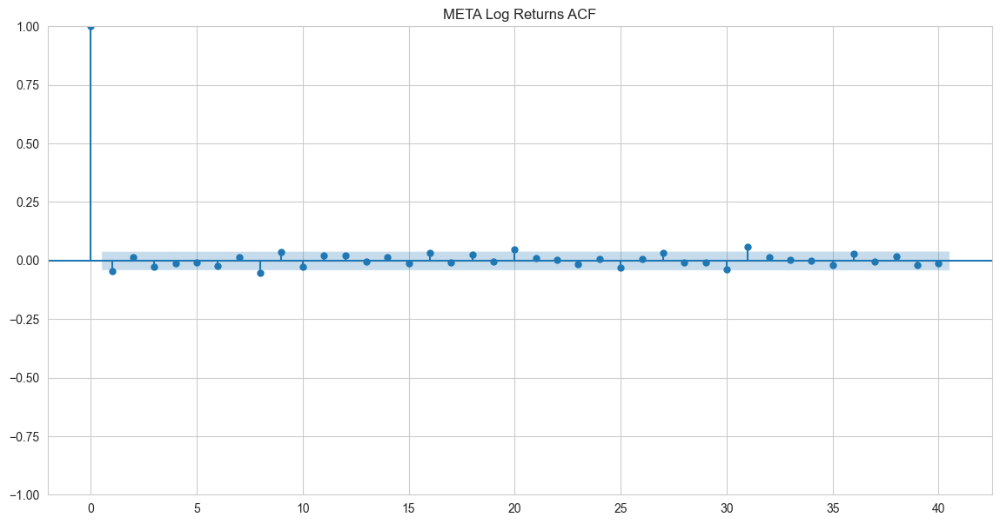

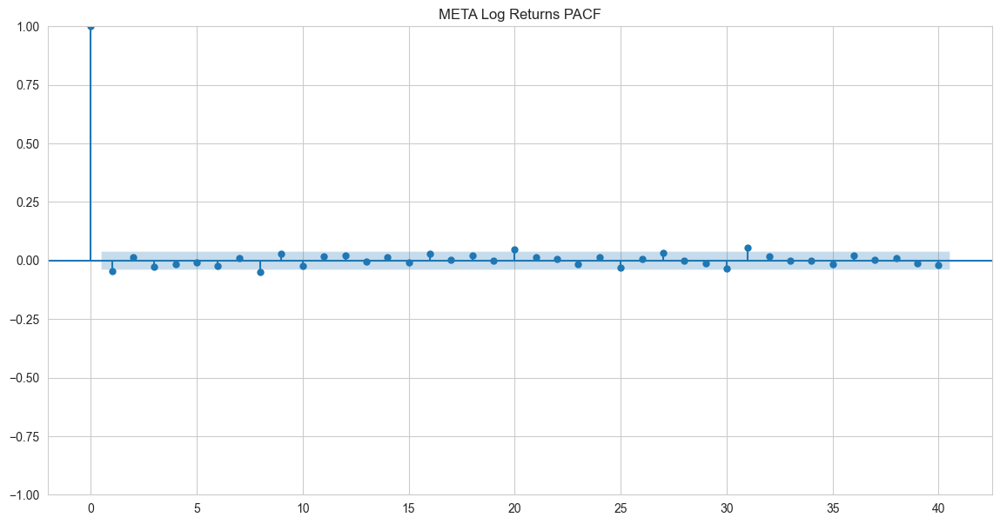

In [5]:
# Price and Returns Plot
print("Generating Price and Returns plots...")
for ticker, df in df_features_dict.items():
    fig, axes = plt.subplots(2, 1, figsize=(14, 8))
    df['Adj Close'].plot(ax=axes[0], title=f'{ticker} Adjusted Close Price')
    df['log_return'].plot(ax=axes[1], title=f'{ticker} Log Returns')
    plt.tight_layout()
    plt.show()

# ACF and PACF for Log Returns
print("Generating ACF and PACF plots...")
for ticker, df in df_features_dict.items():
    # ACF
    fig_acf = plot_acf(df['log_return'].dropna(), lags=40, title=f'{ticker} Log Returns ACF')
    plt.show()

    # PACF
    fig_pacf = plot_pacf(df['log_return'].dropna(), lags=40, title=f'{ticker} Log Returns PACF', method='ywm')
    plt.show()

### **4.1. Adjusted Close Price**

The adjusted close price plots display the expected behavior for financial time series.

* The price series shows **smooth, long-term movements** with clear upward or downward trends depending on the ticker.
* This confirms that the price data is **non-stationary**, which is typical for equity time series.

### **4.2. Log Returns**

The log return plots behave as expected:

* They fluctuate **around zero**, with no visible long-term trend.
* The series is **highly jagged**, reflecting daily market volatility.
* Occasional larger spikes indicate periods of elevated volatility.
  These characteristics are consistent with returns being **stationary** and roughly resembling a white-noise process.

### **4.3. ACF of Log Returns**

The ACF plots exhibit the standard pattern for stock return series:

* **Most autocorrelation coefficients lie within the 95% confidence bands**.
* There is **no meaningful autocorrelation** at higher lags.
* Any small correlations at early lags are minor and expected.
  This supports the conclusion that **log returns show little to no serial correlation**.

### **4.4. PACF of Log Returns**

The PACF plots also align with typical financial return behavior:

* Apart from possibly very small spikes at the first lag, **all partial autocorrelations fall within the confidence bands**.
* No significant structure or pattern is present.
  This indicates that there is **no substantial AR (autoregressive) component** in the return series.

### **4.5. Overall Conclusion**

All plots behave exactly as expected for financial market data:

* **Prices are non-stationary** and trend over time.
* **Log returns are stationary**, centered around zero, and exhibit volatility clustering.
* **ACF and PACF show no significant autocorrelation**, consistent with the common assumption that returns resemble a white-noise process.

---

## **5. Time-Series Modeling Baselines (ARIMA & GARCH)**

### **5.1. SARIMAX Forecast for Log Prices**

We model the **log-transformed prices** using a SARIMAX(1,1,1) model in a walk-forward validation framework. The model predicts the **next period’s log price**, which can be exponentiated to obtain the forecasted price. Performance is evaluated using RMSE and MAE between predicted and actual log prices.


--- Starting SARIMAX Walk-Forward Forecast on AAPL ---


Walk-Forward Steps (AAPL):   0%|          | 2/488 [00:02<09:15,  1.14s/it]

Walk-Forward Steps (AAPL): 100%|██████████| 488/488 [02:58<00:00,  2.74it/s]



AAPL SARIMAX (Log Price) Walk-Forward Forecast RMSE: 0.025864
AAPL SARIMAX (Log Price) Walk-Forward Forecast MAE: 0.017801


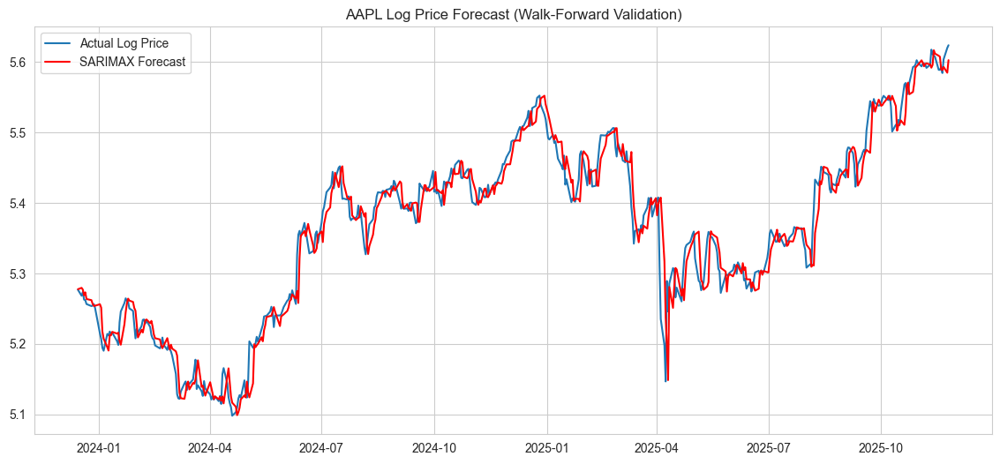


--- Starting SARIMAX Walk-Forward Forecast on MSFT ---


Walk-Forward Steps (MSFT): 100%|██████████| 488/488 [03:13<00:00,  2.53it/s]



MSFT SARIMAX (Log Price) Walk-Forward Forecast RMSE: 0.019681
MSFT SARIMAX (Log Price) Walk-Forward Forecast MAE: 0.014604


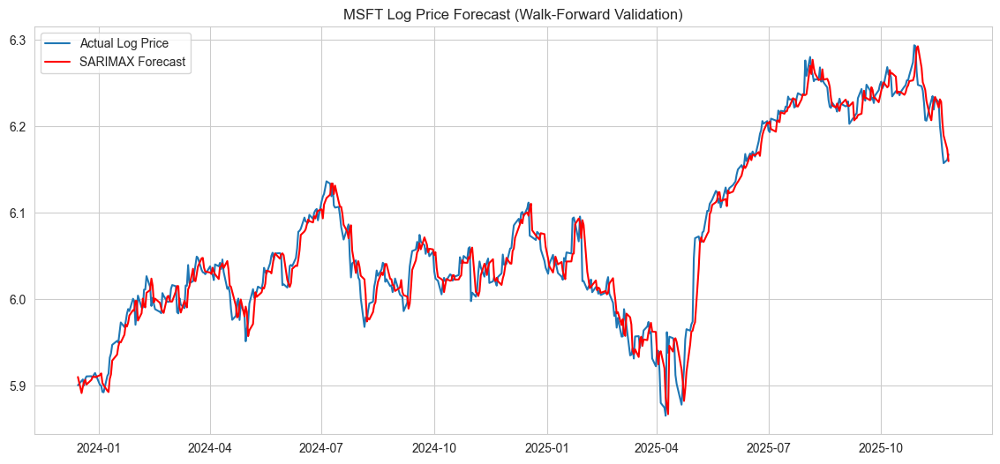


--- Starting SARIMAX Walk-Forward Forecast on GOOGL ---


Walk-Forward Steps (GOOGL): 100%|██████████| 488/488 [02:56<00:00,  2.76it/s]



GOOGL SARIMAX (Log Price) Walk-Forward Forecast RMSE: 0.027145
GOOGL SARIMAX (Log Price) Walk-Forward Forecast MAE: 0.020810


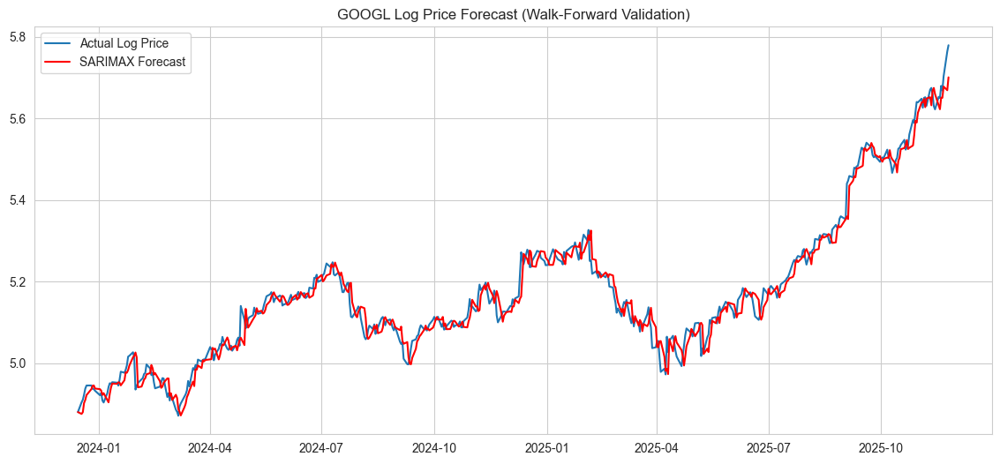


--- Starting SARIMAX Walk-Forward Forecast on AMZN ---


Walk-Forward Steps (AMZN): 100%|██████████| 488/488 [02:26<00:00,  3.32it/s]



AMZN SARIMAX (Log Price) Walk-Forward Forecast RMSE: 0.027812
AMZN SARIMAX (Log Price) Walk-Forward Forecast MAE: 0.020328


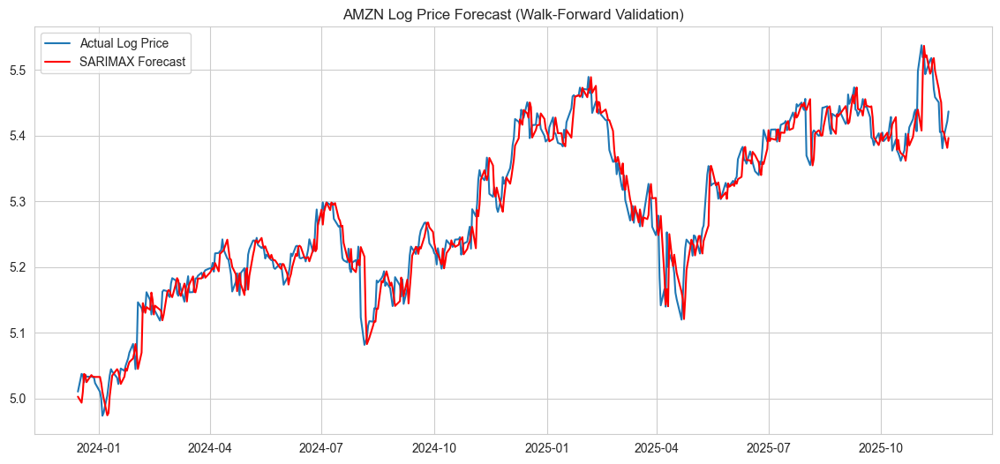


--- Starting SARIMAX Walk-Forward Forecast on META ---


Walk-Forward Steps (META): 100%|██████████| 488/488 [03:39<00:00,  2.22it/s]



META SARIMAX (Log Price) Walk-Forward Forecast RMSE: 0.032083
META SARIMAX (Log Price) Walk-Forward Forecast MAE: 0.022701


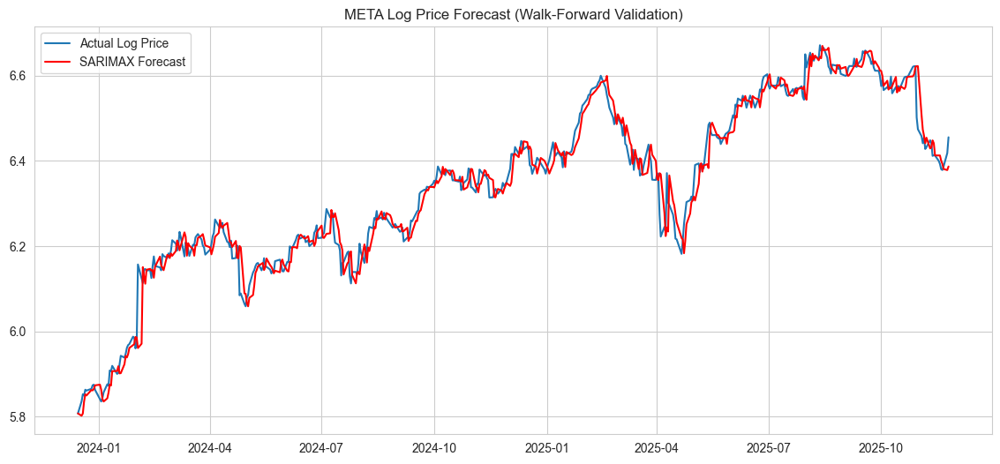


--- SARIMAX Walk-Forward Metrics Summary (Log Price) ---
|       |      RMSE |       MAE |
|:------|----------:|----------:|
| AAPL  | 0.0258638 | 0.0178011 |
| MSFT  | 0.0196812 | 0.0146043 |
| GOOGL | 0.0271454 | 0.0208096 |
| AMZN  | 0.0278116 | 0.0203277 |
| META  | 0.0320826 | 0.022701  |


In [6]:
sarimax_metrics_dict = {}
sarimax_predictions_dict = {}

# Define the forecast parameters for SARIMAX(1, 1, 1)
order = (1, 1, 1) # (p, d=1, q) is correct for log prices

for ticker, df in df_features_dict.items():
    try:
        print(f"\n--- Starting SARIMAX Walk-Forward Forecast on {ticker} ---")
        train_size = int(len(df) * (1 - TEST_SIZE))
        log_prices = np.log(df['Adj Close']).copy() 
        walk_forward_preds = []
        
        with warnings.catch_warnings():
            warnings.filterwarnings("ignore", "A date index has been provided")
            warnings.filterwarnings("ignore", "No supported index is available")
            warnings.filterwarnings("ignore", category=sm.tools.sm_exceptions.ConvergenceWarning) 
            # Start loop from train_size, predict up to the second to last day
            for t in tqdm(range(train_size, len(log_prices) - 1), desc=f"Walk-Forward Steps ({ticker})"):
                
                current_train_data = log_prices.iloc[:t]

                model_sarimax = SARIMAX(
                    current_train_data, 
                    order=order, 
                    enforce_stationarity=False, 
                    enforce_invertibility=False
                ).fit(disp=False, maxiter=100, low_memory=True)
                
                # Predict the next step (T+1)
                forecast = model_sarimax.forecast(steps=1)
                walk_forward_preds.append(forecast.iloc[0])

        # Note: We skip the first prediction since the training data stops at t-1, and prediction is for t.
        # The index starts at train_size + 1 (the first day we are predicting for).
        test_log_prices_actual = log_prices.iloc[train_size+1:]
        sarimax_pred_wf = pd.Series(walk_forward_preds, index=test_log_prices_actual.index, name='SARIMAX_Pred')
        
        sarimax_rmse = np.sqrt(mean_squared_error(test_log_prices_actual, sarimax_pred_wf))
        sarimax_mae = mean_absolute_error(test_log_prices_actual, sarimax_pred_wf)
        sarimax_metrics_dict[ticker] = {'RMSE': sarimax_rmse, 'MAE': sarimax_mae}

        sarimax_predictions_dict[ticker] = sarimax_pred_wf
        
        print(f"\n{ticker} SARIMAX (Log Price) Walk-Forward Forecast RMSE: {sarimax_rmse:.6f}")
        print(f"{ticker} SARIMAX (Log Price) Walk-Forward Forecast MAE: {sarimax_mae:.6f}")

        plt.figure(figsize=(14, 6))
        plt.plot(test_log_prices_actual.index, test_log_prices_actual.values, label='Actual Log Price')
        plt.plot(sarimax_pred_wf.index, sarimax_pred_wf.values, label='SARIMAX Forecast', color='red')
        plt.title(f'{ticker} Log Price Forecast (Walk-Forward Validation)')
        plt.legend()
        plt.show()

    except NameError: 
        print(f"SARIMAX model skipped for {ticker} due to missing packages (statsmodels).")
    except Exception as e:
        print(f"An error occurred while running SARIMAX for {ticker}: {e}")

print("\n--- SARIMAX Walk-Forward Metrics Summary (Log Price) ---")
summary_df = pd.DataFrame(sarimax_metrics_dict).T
print(summary_df.to_markdown())

### **5.2. GARCH for Volatility Forecasting**

GARCH models the time-varying volatility (**conditional heteroskedasticity**) often found in financial returns. We use GARCH(1,1) on the log-returns.


--- Fitting GARCH(1,1) model on AAPL log returns ---

AAPL GARCH(1,1) Summary:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -4669.59
Distribution:                  Normal   AIC:                           9347.18
Method:            Maximum Likelihood   BIC:                           9370.38
                                        No. Observations:                 2441
Date:                Thu, Nov 27 2025   Df Residuals:                     2440
Time:                        22:35:34   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
---------------------------------------------------------------

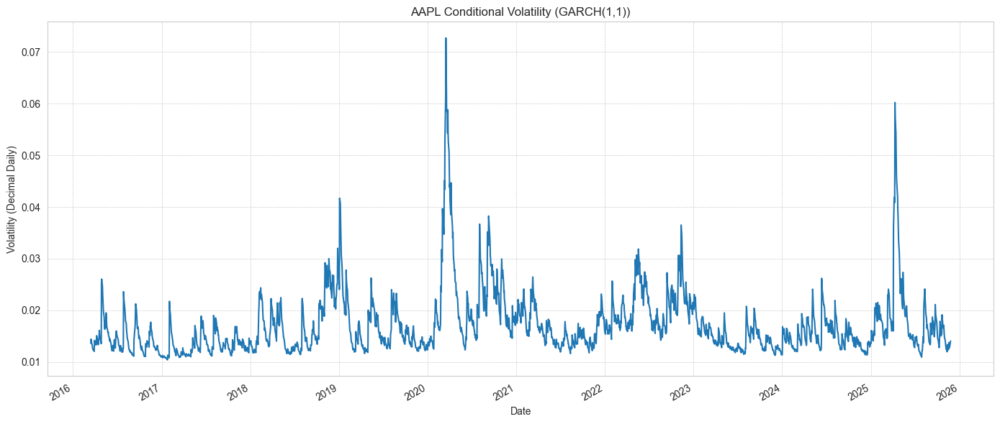


--- Fitting GARCH(1,1) model on MSFT log returns ---

MSFT GARCH(1,1) Summary:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -4436.52
Distribution:                  Normal   AIC:                           8881.03
Method:            Maximum Likelihood   BIC:                           8904.24
                                        No. Observations:                 2441
Date:                Thu, Nov 27 2025   Df Residuals:                     2440
Time:                        22:35:34   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
-----------------------------------------------------------

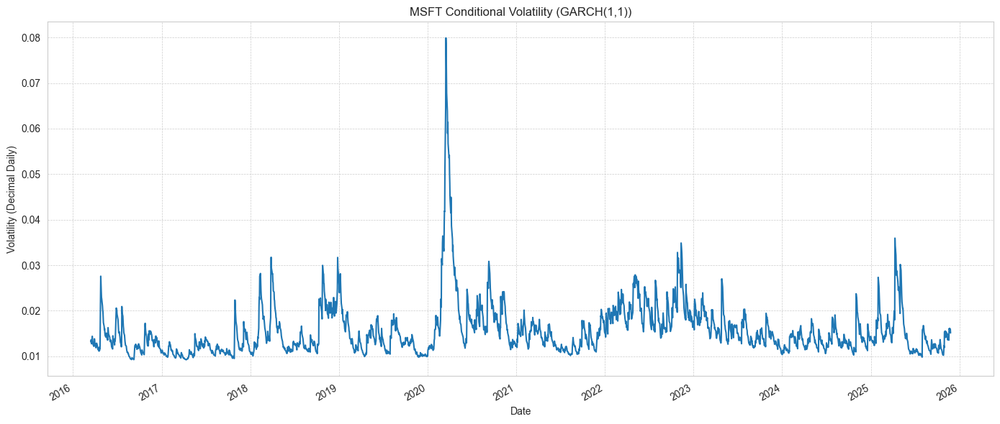


--- Fitting GARCH(1,1) model on GOOGL log returns ---

GOOGL GARCH(1,1) Summary:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -4767.01
Distribution:                  Normal   AIC:                           9542.01
Method:            Maximum Likelihood   BIC:                           9565.21
                                        No. Observations:                 2441
Date:                Thu, Nov 27 2025   Df Residuals:                     2440
Time:                        22:35:35   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
---------------------------------------------------------

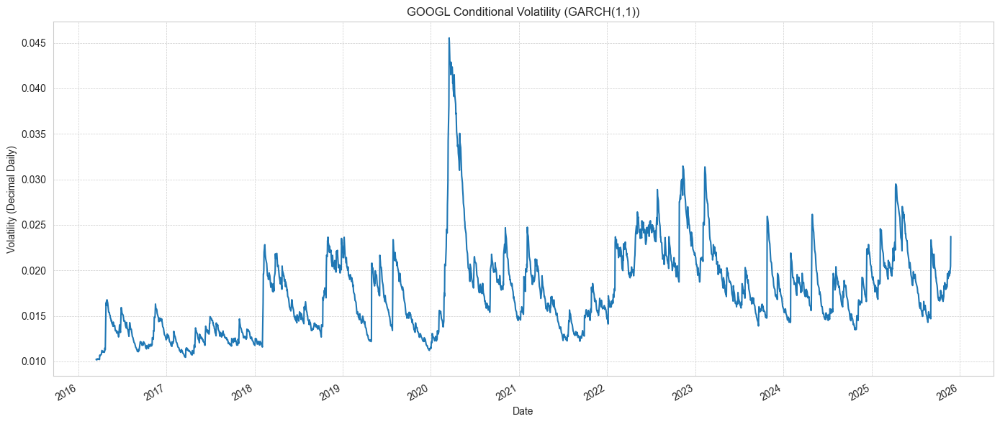


--- Fitting GARCH(1,1) model on AMZN log returns ---

AMZN GARCH(1,1) Summary:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -5003.18
Distribution:                  Normal   AIC:                           10014.4
Method:            Maximum Likelihood   BIC:                           10037.6
                                        No. Observations:                 2441
Date:                Thu, Nov 27 2025   Df Residuals:                     2440
Time:                        22:35:36   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
-----------------------------------------------------------

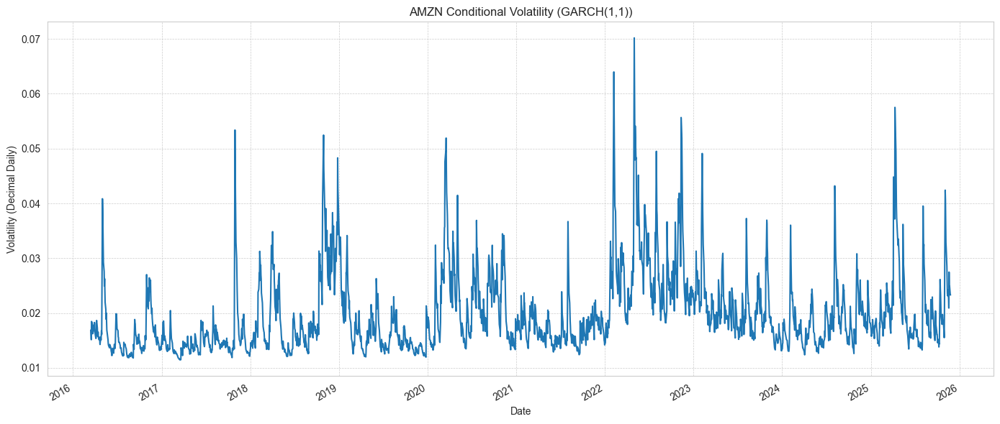


--- Fitting GARCH(1,1) model on META log returns ---

META GARCH(1,1) Summary:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -5479.13
Distribution:                  Normal   AIC:                           10966.3
Method:            Maximum Likelihood   BIC:                           10989.5
                                        No. Observations:                 2441
Date:                Thu, Nov 27 2025   Df Residuals:                     2440
Time:                        22:35:36   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
---------------------------------------------------------------

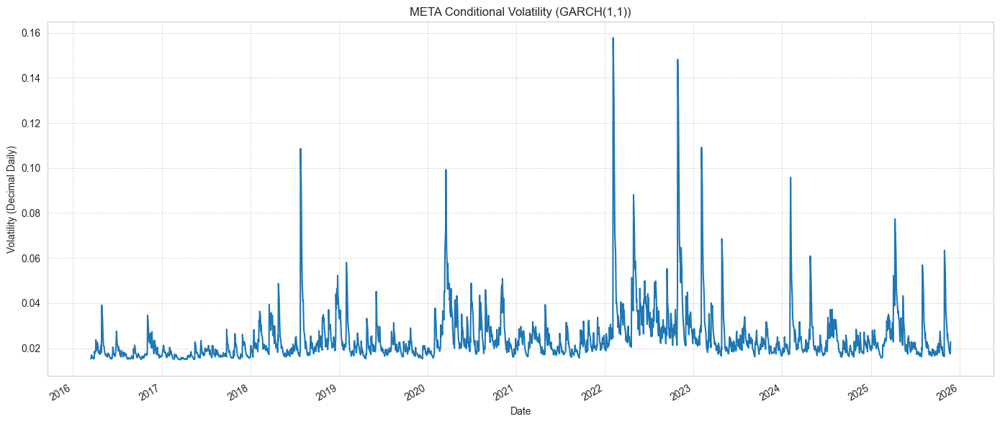

In [7]:
garch_results_dict = {}
garch_cond_vol_dict = {}

for ticker, df in df_features_dict.items():
    try:
        print(f"\n--- Fitting GARCH(1,1) model on {ticker} log returns ---")
        
        garch_model = arch_model(
            df['log_return'].dropna() * 100,
            vol='Garch', p=1, q=1, 
            rescale=True
        )
        garch_fit = garch_model.fit(disp='off')
        
        current_ticker_results = {'fit': garch_fit}
        
        print(f"\n{ticker} GARCH(1,1) Summary:")
        print(garch_fit.summary()) 

        cond_vol = garch_fit.conditional_volatility / 100
        cond_vol.name = 'Conditional Volatility'
        garch_cond_vol_dict[ticker] = cond_vol
        
        forecast_start_date = df.index[-1] 
        
        forecast_result = garch_fit.forecast(horizon=20, start=forecast_start_date)
        
        # Get the standard deviation forecast for the 20 days and convert it back
        forecast_vol = forecast_result.variance.iloc[-1]**0.5 / 100 
        
        # Annualize the daily standard deviation forecast
        annualized_vol_forecast = (forecast_vol * np.sqrt(252))
        
        # Store the forecast alongside the fit object
        current_ticker_results['forecast_annualized_vol'] = annualized_vol_forecast.iloc[-1]
        
        # Assign the final results structure to the main dictionary
        garch_results_dict[ticker] = current_ticker_results
        
        print(f"\n{ticker} 20-day Volatility Forecast (last observation, annualized):")
        print(annualized_vol_forecast.tail(5).to_string())

        plt.figure(figsize=(14, 6))
        cond_vol.plot() 
        plt.title(f'{ticker} Conditional Volatility (GARCH(1,1))')
        plt.ylabel('Volatility (Decimal Daily)')
        plt.xlabel('Date')
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        plt.tight_layout()
        plt.show()
        plt.close()

    except NameError: 
        print(f"\nGARCH model skipped for {ticker} due to missing packages ('arch').")
    except Exception as e:
        print(f"\nAn error occurred while running GARCH for {ticker}: {e}")

---

## **6. Machine Learning Model: XGBoost/LightGBM with Optuna Tuning**

We use **Optuna** to perform Bayesian optimization and find the best hyperparameters.

We use a **walk-forward validation** approach within the Optuna objective to simulate real-world trading conditions and avoid look-ahead bias.

### **6.1. XGBoost**

[I 2025-11-27 22:35:37,815] A new study created in memory with name: xgb_price_forecast_AAPL



--- Starting XGBoost Modeling for AAPL ---
ML Train Size: 1952, Test Size: 489

Starting Optuna Hyperparameter Search for AAPL...


  0%|          | 0/50 [00:00<?, ?it/s]

[I 2025-11-27 22:35:47,512] Trial 0 finished with value: 14.334786114463924 and parameters: {'n_estimators': 330, 'max_depth': 8, 'learning_rate': 0.01637805159352969, 'subsample': 0.8036119927981755, 'colsample_bytree': 0.7153862782532441}. Best is trial 0 with value: 14.334786114463924.
[I 2025-11-27 22:36:01,099] Trial 1 finished with value: 13.516588283006959 and parameters: {'n_estimators': 494, 'max_depth': 7, 'learning_rate': 0.0650487739094801, 'subsample': 0.8297197076753378, 'colsample_bytree': 0.8915660499351938}. Best is trial 1 with value: 13.516588283006959.
[I 2025-11-27 22:36:03,139] Trial 2 finished with value: 30.84273076341656 and parameters: {'n_estimators': 86, 'max_depth': 10, 'learning_rate': 0.01604327349690229, 'subsample': 0.5262046518159305, 'colsample_bytree': 0.5125099268311187}. Best is trial 1 with value: 13.516588283006959.
[I 2025-11-27 22:36:10,822] Trial 3 finished with value: 14.3581551284507 and parameters: {'n_estimators': 488, 'max_depth': 4, 'lea

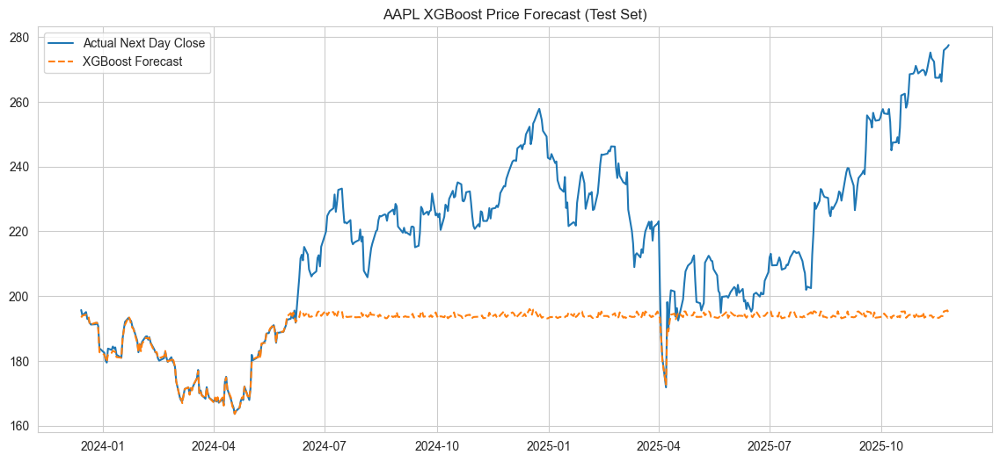

[I 2025-11-27 22:52:10,140] A new study created in memory with name: xgb_price_forecast_MSFT



--- Starting XGBoost Modeling for MSFT ---
ML Train Size: 1952, Test Size: 489

Starting Optuna Hyperparameter Search for MSFT...


  0%|          | 0/50 [00:00<?, ?it/s]

[I 2025-11-27 22:52:14,048] Trial 0 finished with value: 33.290999154005824 and parameters: {'n_estimators': 70, 'max_depth': 8, 'learning_rate': 0.05037306637579852, 'subsample': 0.80992105997583, 'colsample_bytree': 0.9673983929559631}. Best is trial 0 with value: 33.290999154005824.
[I 2025-11-27 22:52:37,841] Trial 1 finished with value: 30.98223284277727 and parameters: {'n_estimators': 248, 'max_depth': 9, 'learning_rate': 0.06419220338237983, 'subsample': 0.883698461638333, 'colsample_bytree': 0.6077600324529637}. Best is trial 1 with value: 30.98223284277727.
[I 2025-11-27 22:52:41,309] Trial 2 finished with value: 39.99780753137024 and parameters: {'n_estimators': 235, 'max_depth': 3, 'learning_rate': 0.011227217406496046, 'subsample': 0.6282285400577201, 'colsample_bytree': 0.6223118318401664}. Best is trial 1 with value: 30.98223284277727.
[I 2025-11-27 22:52:48,187] Trial 3 finished with value: 31.0098702809687 and parameters: {'n_estimators': 67, 'max_depth': 9, 'learning_

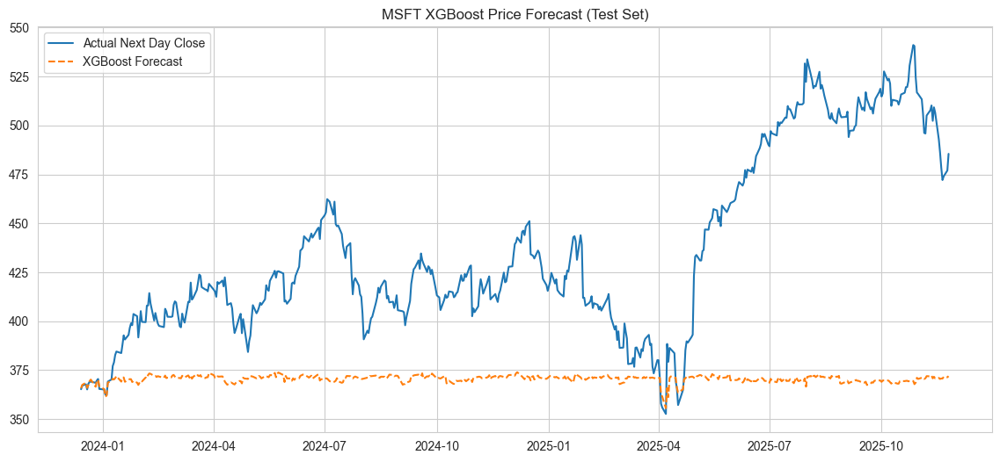

[I 2025-11-27 23:07:59,974] A new study created in memory with name: xgb_price_forecast_GOOGL



--- Starting XGBoost Modeling for GOOGL ---
ML Train Size: 1952, Test Size: 489

Starting Optuna Hyperparameter Search for GOOGL...


  0%|          | 0/50 [00:00<?, ?it/s]

[I 2025-11-27 23:08:12,264] Trial 0 finished with value: 13.240194063231456 and parameters: {'n_estimators': 252, 'max_depth': 7, 'learning_rate': 0.0117689579724678, 'subsample': 0.7813891785401081, 'colsample_bytree': 0.9783841682424674}. Best is trial 0 with value: 13.240194063231456.
[I 2025-11-27 23:08:17,827] Trial 1 finished with value: 14.414785423614688 and parameters: {'n_estimators': 131, 'max_depth': 7, 'learning_rate': 0.01845782027282455, 'subsample': 0.9088317537677835, 'colsample_bytree': 0.7644389934627631}. Best is trial 0 with value: 13.240194063231456.
[I 2025-11-27 23:08:39,971] Trial 2 finished with value: 11.50934110640046 and parameters: {'n_estimators': 224, 'max_depth': 9, 'learning_rate': 0.032644087064200876, 'subsample': 0.837298713341259, 'colsample_bytree': 0.6650392685056878}. Best is trial 2 with value: 11.50934110640046.
[I 2025-11-27 23:08:47,335] Trial 3 finished with value: 11.84687862928438 and parameters: {'n_estimators': 226, 'max_depth': 4, 'lea

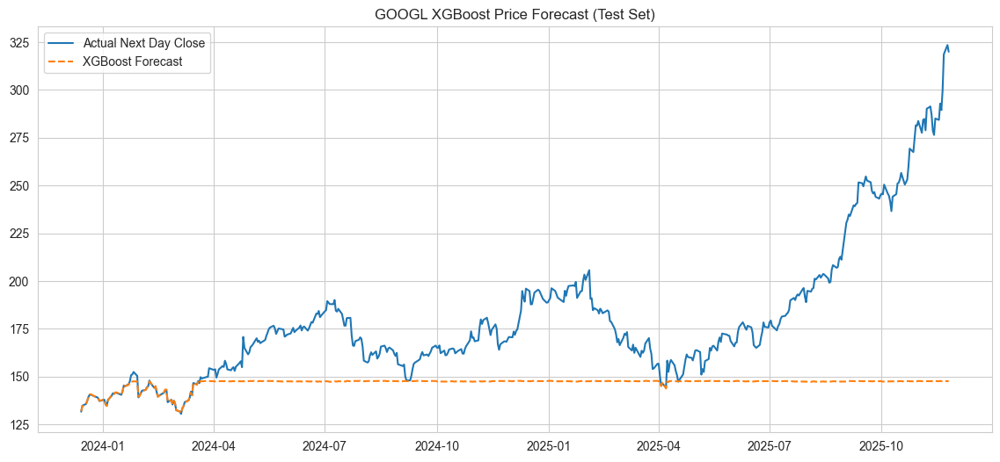

[I 2025-11-27 23:24:20,407] A new study created in memory with name: xgb_price_forecast_AMZN



--- Starting XGBoost Modeling for AMZN ---
ML Train Size: 1952, Test Size: 489

Starting Optuna Hyperparameter Search for AMZN...


  0%|          | 0/50 [00:00<?, ?it/s]

[I 2025-11-27 23:24:25,662] Trial 0 finished with value: 13.005106266620889 and parameters: {'n_estimators': 81, 'max_depth': 10, 'learning_rate': 0.07675959393383276, 'subsample': 0.9280948408410469, 'colsample_bytree': 0.7837781513383202}. Best is trial 0 with value: 13.005106266620889.
[I 2025-11-27 23:24:28,414] Trial 1 finished with value: 12.915385293680364 and parameters: {'n_estimators': 403, 'max_depth': 3, 'learning_rate': 0.0669615249666874, 'subsample': 0.8834411245057501, 'colsample_bytree': 0.5755407074233508}. Best is trial 1 with value: 12.915385293680364.
[I 2025-11-27 23:24:34,137] Trial 2 finished with value: 14.505429082141285 and parameters: {'n_estimators': 188, 'max_depth': 10, 'learning_rate': 0.017324912117742623, 'subsample': 0.7458155232593218, 'colsample_bytree': 0.5287801019235161}. Best is trial 1 with value: 12.915385293680364.
[I 2025-11-27 23:24:35,858] Trial 3 finished with value: 23.174538367067953 and parameters: {'n_estimators': 103, 'max_depth': 5,

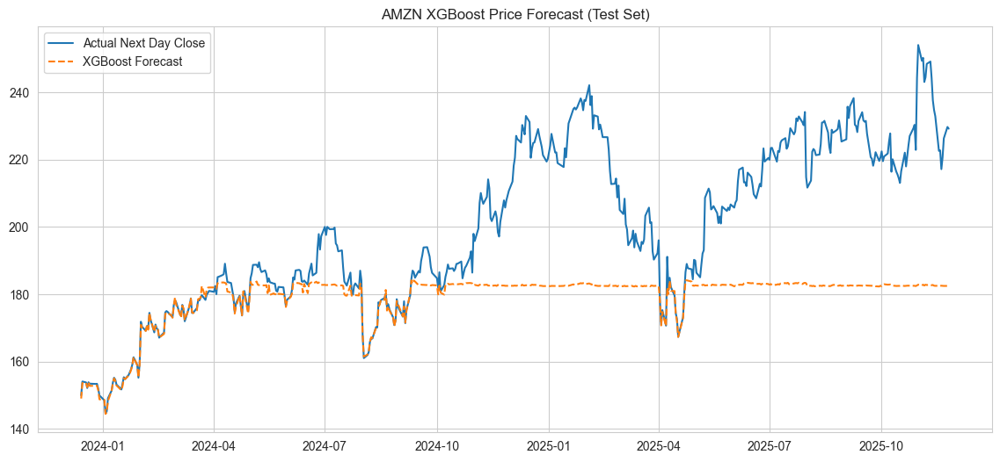

[I 2025-11-27 23:34:10,882] A new study created in memory with name: xgb_price_forecast_META



--- Starting XGBoost Modeling for META ---
ML Train Size: 1952, Test Size: 489

Starting Optuna Hyperparameter Search for META...


  0%|          | 0/50 [00:00<?, ?it/s]

[I 2025-11-27 23:34:29,027] Trial 0 finished with value: 14.710703227116062 and parameters: {'n_estimators': 494, 'max_depth': 10, 'learning_rate': 0.015617538801269546, 'subsample': 0.536460104371602, 'colsample_bytree': 0.9381726648807254}. Best is trial 0 with value: 14.710703227116062.
[I 2025-11-27 23:34:39,508] Trial 1 finished with value: 14.783879067245763 and parameters: {'n_estimators': 331, 'max_depth': 8, 'learning_rate': 0.02383547280970911, 'subsample': 0.9328034441903639, 'colsample_bytree': 0.9279827525980844}. Best is trial 0 with value: 14.710703227116062.
[I 2025-11-27 23:34:46,337] Trial 2 finished with value: 18.067917659309 and parameters: {'n_estimators': 269, 'max_depth': 10, 'learning_rate': 0.01280349663684476, 'subsample': 0.6269295581441816, 'colsample_bytree': 0.9016239938193122}. Best is trial 0 with value: 14.710703227116062.
[I 2025-11-27 23:35:02,663] Trial 3 finished with value: 14.56899254439897 and parameters: {'n_estimators': 431, 'max_depth': 10, '

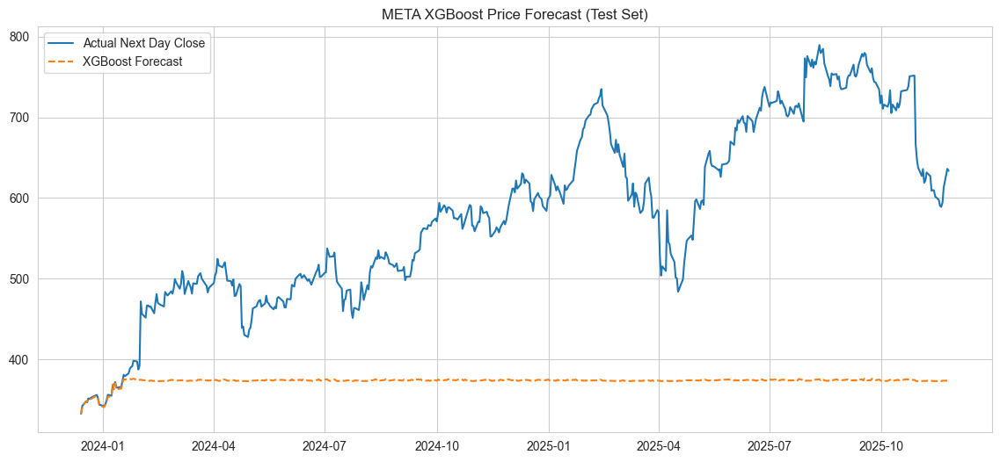


--- XGBoost Test Set Metrics Summary (Target_Close) ---
             RMSE         MAE
AAPL    33.313104   25.031803
MSFT    79.234804   65.108113
GOOGL   48.266539   33.114594
AMZN    27.825443   19.748172
META   232.535814  206.178756


In [8]:
xgb_models_dict = {}
xgb_metrics_dict = {}
xgb_predictions_dict = {}

for ticker, splits in data_splits_dict.items():
    try:
        print(f"\n--- Starting XGBoost Modeling for {ticker} ---")

        df_full = splits['df_full']
        
        ML_FEATURES = [col for col in df_full.columns if col not in ['return', 'log_return', 'Target_Close', 'Target_Signal']]
        X_full = df_full[ML_FEATURES].copy()
        y_full = df_full['Target_Close'].copy()
        
        train_size = len(splits['X_train'])
        X_train, X_test = X_full.iloc[:train_size], X_full.iloc[train_size:]
        y_train, y_test = y_full.iloc[:train_size], y_full.iloc[train_size:]

        print(f"ML Train Size: {len(X_train)}, Test Size: {len(X_test)}")

        def objective(trial, X_train_closure, y_train_closure):
            """Objective function for Optuna to minimize RMSE using Walk-Forward CV."""
            # Hyperparameter search space
            params = {
                'n_estimators': trial.suggest_int('n_estimators', 50, 500),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1, log=True),
                'subsample': trial.suggest_float('subsample', 0.5, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
                'random_state': 42,
                'tree_method': 'hist',
                'objective': 'reg:squarederror' # Explicitly define objective for regression
            }
            
            cv_results = []
            n_splits = 5
            fold_size = len(X_train_closure) // n_splits

            for i in range(n_splits):
                # Ensure the fold indices are sequential for Walk-Forward
                train_start = 0
                train_end = (i + 1) * fold_size
                test_start = train_end
                test_end = (i + 2) * fold_size
                
                if test_start >= len(X_train_closure):
                    continue
                
                X_fold_train = X_train_closure.iloc[train_start:train_end]
                y_fold_train = y_train_closure.iloc[train_start:train_end]
                
                X_fold_test = X_train_closure.iloc[test_start:test_end]
                y_fold_test = y_train_closure.iloc[test_start:test_end]
                
                if len(X_fold_test) == 0:
                    continue
                
                model = xgb.XGBRegressor(**params)
                model.fit(X_fold_train, y_fold_train)
                preds = model.predict(X_fold_test)
                rmse = np.sqrt(mean_squared_error(y_fold_test, preds))
                cv_results.append(rmse)

            return np.mean(cv_results)

        print(f"\nStarting Optuna Hyperparameter Search for {ticker}...")
        study = optuna.create_study(direction='minimize', study_name=f'xgb_price_forecast_{ticker}')
        # Pass train data to objective function using a lambda wrapper
        study.optimize(lambda trial: objective(trial, X_train, y_train), n_trials=OPTUNA_N_TRIALS, show_progress_bar=True)

        best_params = study.best_params
        print(f"\n{ticker} Optuna Finished. Best Params:", best_params)

        final_xgb_model = xgb.XGBRegressor(**best_params, random_state=42, tree_method='hist')
        final_xgb_model.fit(X_train, y_train)
        
        xgb_preds = final_xgb_model.predict(X_test)
        
        xgb_rmse = np.sqrt(mean_squared_error(y_test.values, xgb_preds))
        xgb_mae = mean_absolute_error(y_test.values, xgb_preds)
        
        print(f"\n{ticker} XGBoost (Tuned) Test RMSE: {xgb_rmse:.4f}")
        print(f"{ticker} XGBoost (Tuned) Test MAE: {xgb_mae:.4f}")

        xgb_models_dict[ticker] = final_xgb_model
        xgb_metrics_dict[ticker] = {'RMSE': xgb_rmse, 'MAE': xgb_mae}
        xgb_predictions_dict[ticker] = pd.Series(xgb_preds, index=X_test.index, name='XGB_Forecast')

        plt.figure(figsize=(14, 6))
        plt.plot(y_test.index, y_test.values, label='Actual Next Day Close')
        plt.plot(xgb_predictions_dict[ticker].index, xgb_predictions_dict[ticker].values, label='XGBoost Forecast', linestyle='--')
        plt.title(f'{ticker} XGBoost Price Forecast (Test Set)')
        plt.legend()
        plt.show()
        plt.close()


    except NameError:
        print(f"XGBoost/Optuna model skipped for {ticker} due to missing packages.")
    except Exception as e:
        print(f"An error occurred while running XGBoost for {ticker}: {e}")

print("\n--- XGBoost Test Set Metrics Summary (Target_Close) ---")
summary_df = pd.DataFrame(xgb_metrics_dict).T
print(summary_df.to_string())

### **6.2. LightGBM**

[I 2025-11-27 23:41:00,664] A new study created in memory with name: LGBM_AAPL



--- Starting LightGBM Modeling for AAPL ---
ML Train Size: 1952, Test Size: 489
Number of features selected: 19

Starting Optuna Hyperparameter Search for AAPL...


  0%|          | 0/40 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4592
[LightGBM] [Info] Number of data points in the train set: 1952, number of used features: 19
[LightGBM] [Info] Start training from score 89.383077
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

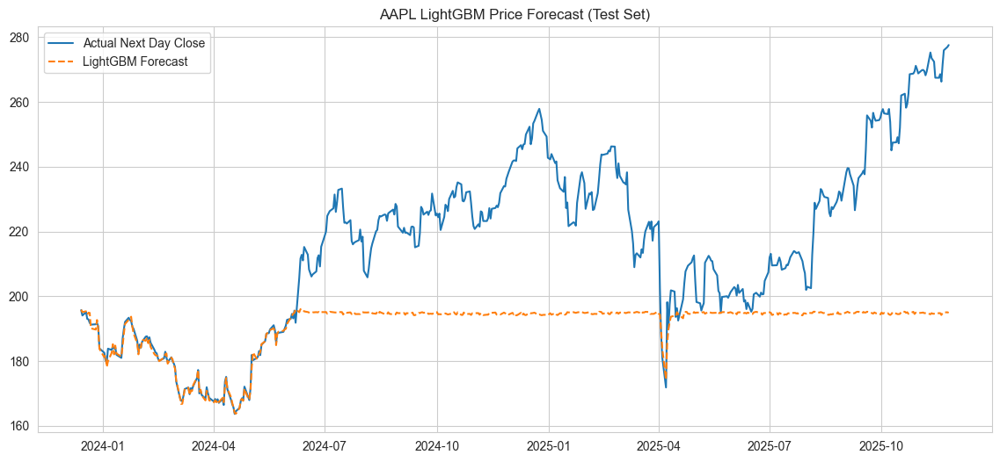

[I 2025-11-27 23:43:35,673] A new study created in memory with name: LGBM_MSFT



--- Starting LightGBM Modeling for MSFT ---
ML Train Size: 1952, Test Size: 489
Number of features selected: 19

Starting Optuna Hyperparameter Search for MSFT...


  0%|          | 0/40 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000697 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4592
[LightGBM] [Info] Number of data points in the train set: 1952, number of used features: 19
[LightGBM] [Info] Start training from score 170.944899
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

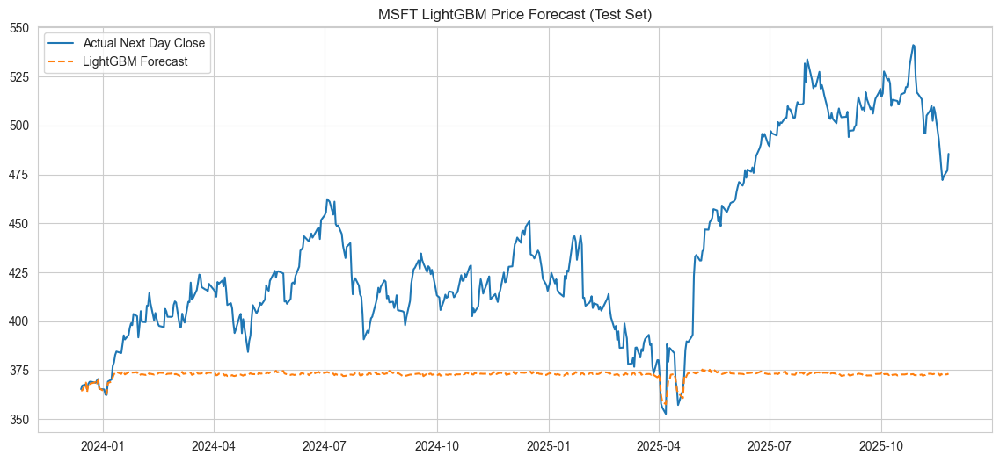

[I 2025-11-27 23:45:14,791] A new study created in memory with name: LGBM_GOOGL



--- Starting LightGBM Modeling for GOOGL ---
ML Train Size: 1952, Test Size: 489
Number of features selected: 19

Starting Optuna Hyperparameter Search for GOOGL...


  0%|          | 0/40 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000550 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4592
[LightGBM] [Info] Number of data points in the train set: 1952, number of used features: 19
[LightGBM] [Info] Start training from score 79.270940
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

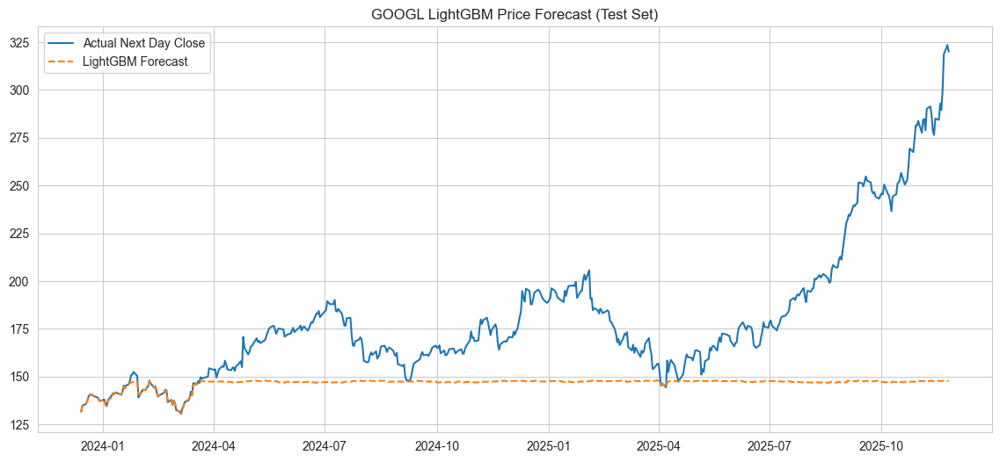

[I 2025-11-27 23:47:18,971] A new study created in memory with name: LGBM_AMZN



--- Starting LightGBM Modeling for AMZN ---
ML Train Size: 1952, Test Size: 489
Number of features selected: 19

Starting Optuna Hyperparameter Search for AMZN...


  0%|          | 0/40 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000463 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4592
[LightGBM] [Info] Number of data points in the train set: 1952, number of used features: 19
[LightGBM] [Info] Start training from score 102.052717
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

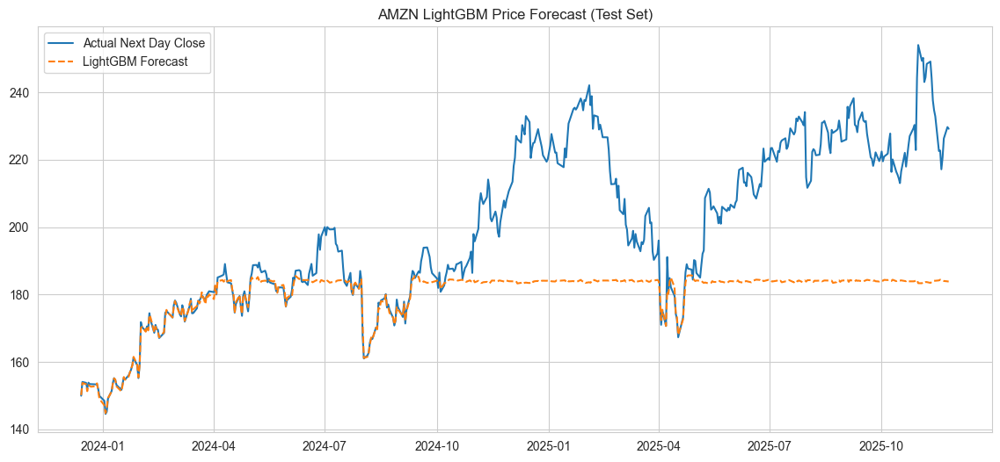

[I 2025-11-27 23:51:17,685] A new study created in memory with name: LGBM_META



--- Starting LightGBM Modeling for META ---
ML Train Size: 1952, Test Size: 489
Number of features selected: 19

Starting Optuna Hyperparameter Search for META...


  0%|          | 0/40 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000590 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4592
[LightGBM] [Info] Number of data points in the train set: 1952, number of used features: 19
[LightGBM] [Info] Start training from score 203.544959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

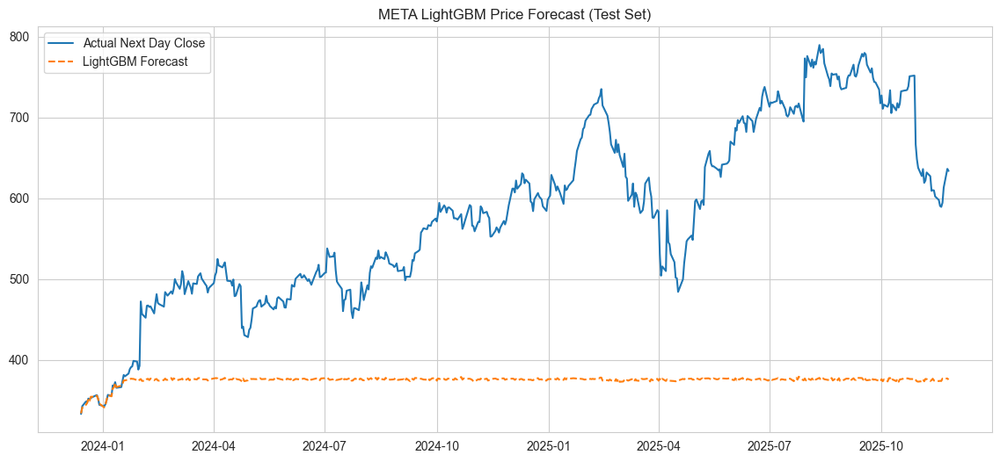


--- LightGBM Test Set Metrics Summary (Target_Close) ---
             RMSE         MAE
AAPL    32.800201   24.584238
MSFT    77.133478   62.911935
GOOGL   48.358021   33.263068
AMZN    26.948037   18.852830
META   231.373139  204.920264


In [9]:
lgbm_models_dict = {}
lgbm_metrics_dict = {}
lgbm_predictions_dict = {}

def sanitize_feature_names(df):
    """Sanitizes feature names for LightGBM compatibility."""
    # Coerce to string first, then sanitize special characters
    new_columns = [re.sub(r'[^A-Za-z0-9_]+', '_', str(col)) for col in df.columns]
    # NOTE: We operate on a copy to prevent side-effects on data_splits_dict['df_full'] later
    df_copy = df.copy()
    df_copy.columns = new_columns
    return df_copy

def objective_lgbm(trial, X_train_closure, y_train_closure):
    """Optuna objective for LightGBM regression with pruning."""
    # Hyperparameter search space
    params = {
        "objective": "regression",
        "metric": "rmse",
        "boosting_type": "gbdt",
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.2, log=True),
        "n_estimators": trial.suggest_int("n_estimators", 200, 2000),
        "num_leaves": trial.suggest_int("num_leaves", 20, 300),
        "max_depth": trial.suggest_int("max_depth", 3, 14),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
        "random_state": 42,
        "n_jobs": -1,
    }
    model = lgb.LGBMRegressor(**params)
    model.fit(
        X_train_closure, 
        y_train_closure,
        eval_set=[(X_train_closure, y_train_closure)],
        eval_metric="rmse",
        callbacks=[lgb.early_stopping(stopping_rounds=100),
                   lgb.log_evaluation(0)]  # Silent training
    )
    best_rmse = model.best_score_["training"]["rmse"]
    return best_rmse

for ticker, splits in data_splits_dict.items():
    try:
        print(f"\n--- Starting LightGBM Modeling for {ticker} ---")

        df_full = splits['df_full']

        y_full = df_full['Target_Close'].copy()
        
        df_sanitized = sanitize_feature_names(df_full) 
        
        NON_FEATURE_COLS = ['return', 'log_return', 'Target_Close', 'Adj_Close', 'High', 'Low', 'Open', 'Close', 'Volume']
        
        ML_FEATURES = [
            col for col in df_sanitized.columns 
            if col not in NON_FEATURE_COLS and not col.startswith('Target_')
        ]
        
        X_full = df_sanitized[ML_FEATURES].copy()
        
        X_train_index = splits['X_train'].index
        X_test_index = splits['X_test'].index
        
        X_train, X_test = X_full.loc[X_train_index], X_full.loc[X_test_index]
        y_train, y_test = y_full.loc[X_train_index], y_full.loc[X_test_index]
        
        print(f"ML Train Size: {len(X_train)}, Test Size: {len(X_test)}")
        print(f"Number of features selected: {len(ML_FEATURES)}")


        print(f"\nStarting Optuna Hyperparameter Search for {ticker}...")
        study = optuna.create_study(
            direction="minimize",
            study_name=f"LGBM_{ticker}",
            sampler=optuna.samplers.TPESampler(seed=42),
            pruner=optuna.pruners.MedianPruner(n_startup_trials=10, n_warmup_steps=100)
        )
        study.optimize(
            lambda trial: objective_lgbm(trial, X_train, y_train),
            n_trials=40,
            show_progress_bar=True
        )
        best_params = study.best_params
        print(f"{ticker} Optuna Finished. Best Params:", best_params)
        
        # Clean up parameters for final fit
        final_params = best_params.copy()
        final_params.pop('objective', None)
        final_params.pop('metric', None)
        final_params.pop('verbose', None)

        final_lgbm_model = lgb.LGBMRegressor(**final_params, random_state=42)
        
        final_lgbm_model.fit(X_train, y_train)
        
        lgbm_preds = final_lgbm_model.predict(X_test)
        
        lgbm_rmse = np.sqrt(mean_squared_error(y_test.values, lgbm_preds))
        lgbm_mae = mean_absolute_error(y_test.values, lgbm_preds)
        
        print(f"\n{ticker} LightGBM (Tuned) Test RMSE: {lgbm_rmse:.4f}")
        print(f"{ticker} LightGBM (Tuned) Test MAE: {lgbm_mae:.4f}")

        lgbm_models_dict[ticker] = final_lgbm_model
        lgbm_metrics_dict[ticker] = {'RMSE': lgbm_rmse, 'MAE': lgbm_mae}
        lgbm_predictions_dict[ticker] = pd.Series(lgbm_preds, index=X_test.index, name='LGBM_Forecast')

        plt.figure(figsize=(14, 6))
        plt.plot(y_test.index, y_test.values, label='Actual Next Day Close')
        plt.plot(lgbm_predictions_dict[ticker].index, lgbm_predictions_dict[ticker].values, label='LightGBM Forecast', linestyle='--')
        plt.title(f'{ticker} LightGBM Price Forecast (Test Set)')
        plt.legend()
        plt.show()
        plt.close()

    except NameError as e: 
        print(f"LightGBM/Optuna model skipped for {ticker}. Missing packages or variables: {e}")
    except Exception as e:
        print(f"An error occurred while running LightGBM for {ticker}: {e}")

print("\n--- LightGBM Test Set Metrics Summary (Target_Close) ---")
summary_df = pd.DataFrame(lgbm_metrics_dict).T
print(summary_df.to_string())

Both $\text{XGBoost}$ and $\text{LightGBM}$ are tree-based models that treat each day's data as an independent observation. They look at features ($X_t$) and predict the target ($Y_{t+1}$).

**Result:** They learn the relationship between features and price level within the range of the training data. When the price enters a sustained trend (a new high or new low), they cannot extrapolate that trend, and the prediction reverts to the average value seen during training—this is the flatlining we observe.

---

## **7. Deep Learning Model: LSTM**

Since we've effectively exhausted the traditional $\text{ML}$ approaches for price regression, the only viable remaining modeling approach designed specifically to solve this issue, is the LSTM (Long Short-Term Memory) Network.

The $\text{LSTM}$ network is a type of Recurrent Neural Network ($\text{RNN}$) that fundamentally changes how the model perceives the data:
- **Sequential Memory:** The $\text{LSTM}$ has an internal memory cell that allows it to retain information over long sequences of time. It doesn't look at a single day's features ($X_t$); it looks at the entire sequence (e.g., $X_{t-30}, \ldots, X_{t-1}, X_t$) to make a prediction ($Y_{t+1}$).
- **Trend Extrapolation:** Because it learns the dynamics of the price movement across time, it is far more capable of extrapolating the price trend than a tree-based model.

LSTMs are effective for sequence prediction. We refine the data preparation to use a proper **MinMaxScaler** and a helper function to create the time-stepped sequences, a necessary step for recurrent networks.


--- Starting Univariate LSTM Modeling for AAPL ---
LSTM Train set shape: (1892, 60, 1)
Training LSTM Model for AAPL...

AAPL LSTM Forecast RMSE: 7.6717
AAPL LSTM Forecast MAE: 5.9542


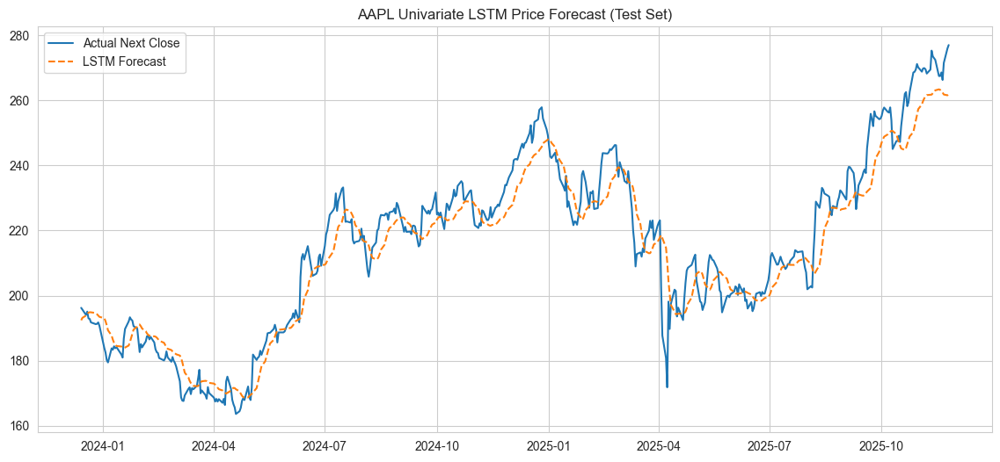


--- Starting Univariate LSTM Modeling for MSFT ---
LSTM Train set shape: (1892, 60, 1)
Training LSTM Model for MSFT...

MSFT LSTM Forecast RMSE: 20.5413
MSFT LSTM Forecast MAE: 17.8488


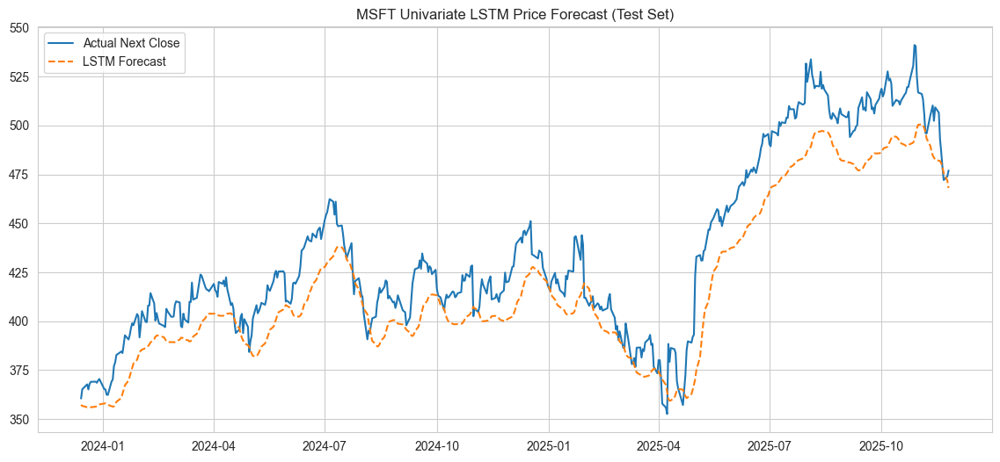


--- Starting Univariate LSTM Modeling for GOOGL ---
LSTM Train set shape: (1892, 60, 1)
Training LSTM Model for GOOGL...

GOOGL LSTM Forecast RMSE: 7.4005
GOOGL LSTM Forecast MAE: 5.2421


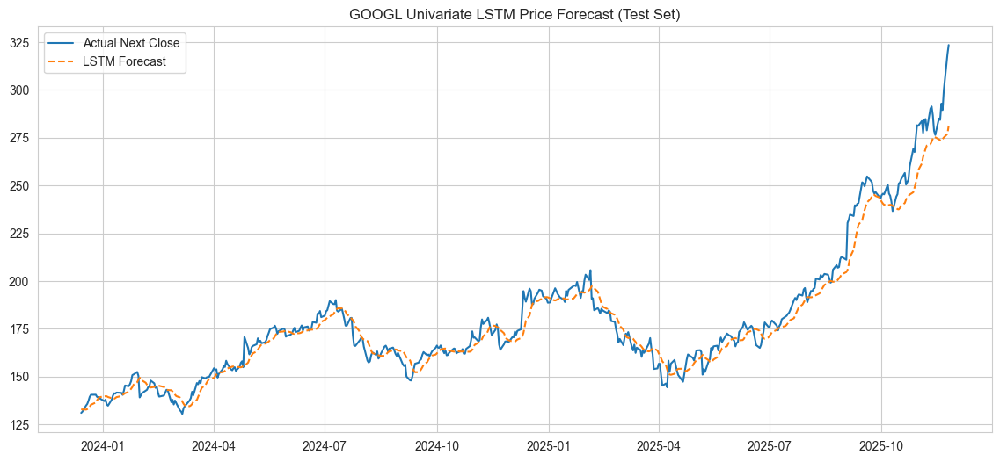


--- Starting Univariate LSTM Modeling for AMZN ---
LSTM Train set shape: (1892, 60, 1)
Training LSTM Model for AMZN...

AMZN LSTM Forecast RMSE: 8.0573
AMZN LSTM Forecast MAE: 6.5017


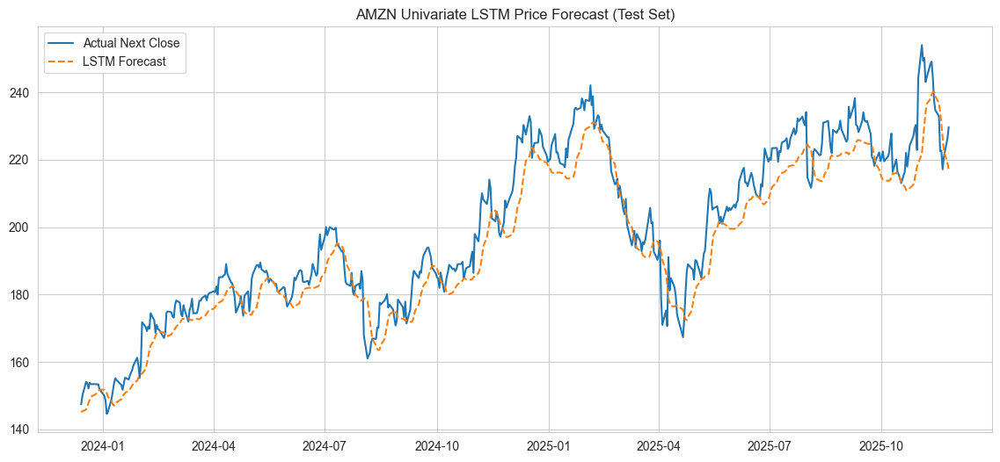


--- Starting Univariate LSTM Modeling for META ---
LSTM Train set shape: (1892, 60, 1)
Training LSTM Model for META...

META LSTM Forecast RMSE: 31.1571
META LSTM Forecast MAE: 25.7127


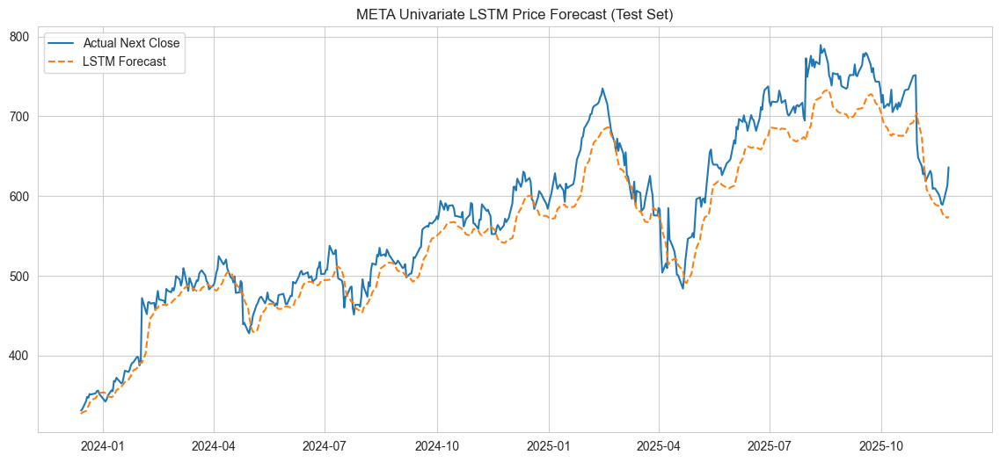


--- Univariate LSTM Test Set Metrics Summary (Target_Close) ---
            RMSE        MAE
AAPL    7.671684   5.954165
MSFT   20.541275  17.848800
GOOGL   7.400542   5.242079
AMZN    8.057271   6.501679
META   31.157148  25.712697


In [10]:
LOOKBACK_WINDOW = 60 # TIME_STEP
FORECAST_HORIZON = 1 # Predict T+1

lstm_univariate_models_dict = {}
lstm_univariate_metrics_dict = {}
lstm_univariate_predictions_dict = {}
lstm_univariate_scalers_dict = {}


def create_lstm_dataset(dataset, time_step=LOOKBACK_WINDOW):
    """Creates 3D sequences (samples, timesteps, 1) for LSTM from a single feature."""
    dataX, dataY = [], []
    for i in range(len(dataset) - time_step - FORECAST_HORIZON + 1):
        # a: past time_step days
        a = dataset[i:(i + time_step), 0]
        dataX.append(a)
        # Target is T + forecast horizon day
        dataY.append(dataset[i + time_step + FORECAST_HORIZON - 1, 0])
    return np.array(dataX), np.array(dataY)

for ticker, splits in data_splits_dict.items():
    try:
        print(f"\n--- Starting Univariate LSTM Modeling for {ticker} ---")

        df_full = splits['df_full']
        train_size = len(splits['X_train'])
        
        data = df_full[['Adj Close']].values.reshape(-1, 1)
        
        SCALER = MinMaxScaler(feature_range=(0, 1))
        scaled_data = SCALER.fit_transform(data)
        
        train_data = scaled_data[:train_size]
        test_data = scaled_data[train_size - LOOKBACK_WINDOW:]
        
        X_train_lstm, y_train_lstm = create_lstm_dataset(train_data, LOOKBACK_WINDOW)
        X_test_lstm, y_test_lstm = create_lstm_dataset(test_data, LOOKBACK_WINDOW)

        X_train_lstm = X_train_lstm.reshape(X_train_lstm.shape[0], X_train_lstm.shape[1], 1)
        X_test_lstm = X_test_lstm.reshape(X_test_lstm.shape[0], X_test_lstm.shape[1], 1)

        print(f"LSTM Train set shape: {X_train_lstm.shape}")

        model = Sequential()
        model.add(LSTM(units=50, return_sequences=True, input_shape=(LOOKBACK_WINDOW, 1)))
        model.add(Dropout(0.2))
        model.add(LSTM(units=50, return_sequences=False))
        model.add(Dropout(0.2))
        model.add(Dense(units=1))

        model.compile(optimizer='adam', loss='mean_squared_error')
        
        print(f"Training LSTM Model for {ticker}...")
        model.fit(
            X_train_lstm, 
            y_train_lstm, 
            epochs=25, 
            batch_size=32, 
            verbose=0
        )
        
        lstm_predictions_scaled = model.predict(X_test_lstm, verbose=0)
        
        # Inverse transform to get actual price values
        lstm_predictions = SCALER.inverse_transform(lstm_predictions_scaled).flatten()
        y_test_lstm_actual = SCALER.inverse_transform(y_test_lstm.reshape(-1, 1)).flatten()

        required_len = len(lstm_predictions)
        full_index = df_full.index
        # Calculate the start position of the target values in the original df_full index
        test_index_start = len(full_index) - required_len

        # Slice the full index to get the aligned dates
        lstm_index = full_index[test_index_start:]

        # Align predictions with the actual dates in the test set
        lstm_predictions_series = pd.Series(lstm_predictions, index=lstm_index, name='LSTM_Forecast')
        y_test_lstm_actual_series = pd.Series(y_test_lstm_actual, index=lstm_index, name='Actual_Next_Close')
        
        lstm_rmse = np.sqrt(mean_squared_error(y_test_lstm_actual_series, lstm_predictions_series))
        lstm_mae = mean_absolute_error(y_test_lstm_actual_series, lstm_predictions_series)
        
        print(f"\n{ticker} LSTM Forecast RMSE: {lstm_rmse:.4f}")
        print(f"{ticker} LSTM Forecast MAE: {lstm_mae:.4f}")

        lstm_univariate_models_dict[ticker] = model
        lstm_univariate_scalers_dict[ticker] = SCALER
        lstm_univariate_metrics_dict[ticker] = {'RMSE': lstm_rmse, 'MAE': lstm_mae}
        lstm_univariate_predictions_dict[ticker] = lstm_predictions_series

        plt.figure(figsize=(14, 6))
        plt.plot(y_test_lstm_actual_series.index, y_test_lstm_actual_series.values, label='Actual Next Close')
        plt.plot(lstm_predictions_series.index, lstm_predictions_series.values, label='LSTM Forecast', linestyle='--')
        plt.title(f'{ticker} Univariate LSTM Price Forecast (Test Set)')
        plt.legend()
        plt.show()
        plt.close()

    except NameError: 
        print(f"LSTM model skipped for {ticker} due to missing packages (tensorflow/keras/MinMaxScaler).")
    except Exception as e:
        print(f"An error occurred while running LSTM for {ticker}: {e}")

print("\n--- Univariate LSTM Test Set Metrics Summary (Target_Close) ---")
summary_df = pd.DataFrame(lstm_univariate_metrics_dict).T
print(summary_df.to_string())

### **Model Comparison: SARIMAX vs Univariate LSTM**

We evaluated both **SARIMAX** and **univariate LSTM** models to forecast stock prices and determine the best approach for vectorbt backtesting. The following points summarize the comparison:

#### **1. Target and Input Data**

| Model   | Input Data                            | Target Variable       |
| ------- | ------------------------------------- | --------------------- |
| SARIMAX | Log-transformed adjusted close prices | Next-day log price    |
| LSTM    | Scaled adjusted close prices          | Next-day actual price |

* SARIMAX operates in **log-price space**, stabilizing variance and making the series closer to stationary.
* LSTM models **raw prices**, scaled to [0,1], which can lead to systematic underestimation if the model struggles to match the absolute levels.

#### **2. Forecasting Method**

* **SARIMAX**: Uses **walk-forward validation**, retraining at each step to adapt to evolving trends.
* **LSTM**: Trained once on a rolling window; may underpredict absolute prices due to scaling and smoothing tendencies.

#### **3. Error Metrics**

| Ticker | SARIMAX RMSE (log-price) | LSTM RMSE (price) | SARIMAX MAE | LSTM MAE |
| ------ | ------------------------ | ----------------- | ----------- | -------- |
| AAPL   | 0.02586                  | 7.67              | 0.0178      | 5.95     |
| MSFT   | 0.01968                  | 20.54             | 0.0146      | 17.85    |
| GOOGL  | 0.02714                  | 7.40              | 0.0208      | 5.24     |
| AMZN   | 0.02781                  | 8.06              | 0.0203      | 6.50     |
| META   | 0.03208                  | 31.16             | 0.0227      | 25.71    |

> Note: SARIMAX errors are in log-price units, LSTM in actual price units. Despite the scale difference, SARIMAX produces **low, stable errors** and forecasts that closely track both trend and levels, while LSTM forecasts, though smooth, systematically underpredict actual prices.

#### **4. Visual Comparison Observation**

* **SARIMAX predictions** align closely with actual log-price trajectories, maintaining both trend and price level.
* **LSTM predictions**, although smooth and trend-following, consistently **underestimate prices**, creating a persistent gap from actual values.
* This systematic bias in LSTM forecasts makes them **less reliable for backtesting**, whereas SARIMAX provides both accurate levels and trend alignment.

#### **5. Complexity and Interpretability**

| Model   | Training Complexity                                        | Interpretability                                               |
| ------- | ---------------------------------------------------------- | -------------------------------------------------------------- |
| SARIMAX | Low                                                        | High – AR, MA, differencing terms are interpretable            |
| LSTM    | High – layers, neurons, dropout, learning rate need tuning | Low – black-box neural network, difficult to explain decisions |

#### **6. Practical Considerations for Backtesting**

* **SARIMAX Advantages**:
  * Produces **realistic price paths** suitable for trading simulations.
  * Adapts via walk-forward retraining to evolving trends.
  * Forecasts are interpretable and reproducible.

* **LSTM Limitations**:
  * Systematically underpredicts prices, creating bias in backtesting.
  * Smooth predictions may fail to capture absolute price levels accurately.
  * Requires larger datasets and careful tuning; overfitting is a risk.

#### **8. Conclusion**
For **vectorbt backtesting**, SARIMAX is the preferred model because it balances **stability, interpretability, and realistic forecast paths**. While LSTM captures trend direction, its **systematic underprediction** and smoothing make it less suitable for portfolio simulation. SARIMAX forecasts provide **accurate, level-aligned, and reproducible estimates**, ensuring robust backtesting results.

---

## **8. Backtesting & Strategy Evaluation (VectorBT)**

This section demonstrates two backtesting approaches:

1.  A traditional **Momentum Strategy** baseline.
2.  A robust **VectorBT** backtest using the **LSTM predictions** to generate trading signals, showcasing a **model-driven strategy**.

### **8.1. Simple Momentum Strategy (Baseline)**
This code implements a **simple momentum trading strategy** for each stock, compares its performance to a **buy-and-hold approach**, summarizes the results, and visualizes the cumulative returns over time. It shows whether the momentum strategy would have outperformed or underperformed holding the stock over the same period.

The strategy is a **simple momentum strategy** based on past price performance:

* **Buy signal:** If the stock’s price has increased over the past 20 trading days (default lookback), the strategy invests in the stock.
* **Hold/cash signal:** If the stock’s price hasn’t increased over that period, the strategy stays out of the market (no position).

Essentially, it **buys stocks that have recently gone up**, aiming to ride the trend, and avoids stocks that haven’t gained momentum.

--- Running Simple Momentum Strategy (Buy/Hold vs. 20-Day Momentum) ---

AAPL Strategy Results:
Final Buy & Hold Value: $1,168,280.91
Final Strategy Value: $793,954.82

MSFT Strategy Results:
Final Buy & Hold Value: $1,009,270.40
Final Strategy Value: $190,686.13

GOOGL Strategy Results:
Final Buy & Hold Value: $867,795.95
Final Strategy Value: $296,737.14

AMZN Strategy Results:
Final Buy & Hold Value: $796,055.59
Final Strategy Value: $491,079.51

META Strategy Results:
Final Buy & Hold Value: $578,424.24
Final Strategy Value: $436,730.78

--- Final Momentum Strategy Summary ---
       Buy_Hold_Value Strategy_Value Return_Outperformance
Ticker                                                    
AAPL    $1,168,280.91    $793,954.82               -32.04%
MSFT    $1,009,270.40    $190,686.13               -81.11%
GOOGL     $867,795.95    $296,737.14               -65.81%
AMZN      $796,055.59    $491,079.51               -38.31%
META      $578,424.24    $436,730.78               -24.50%

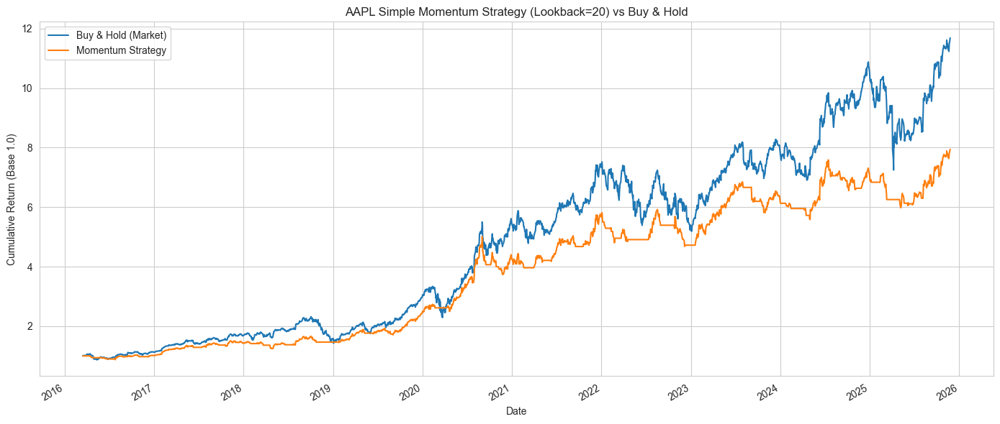

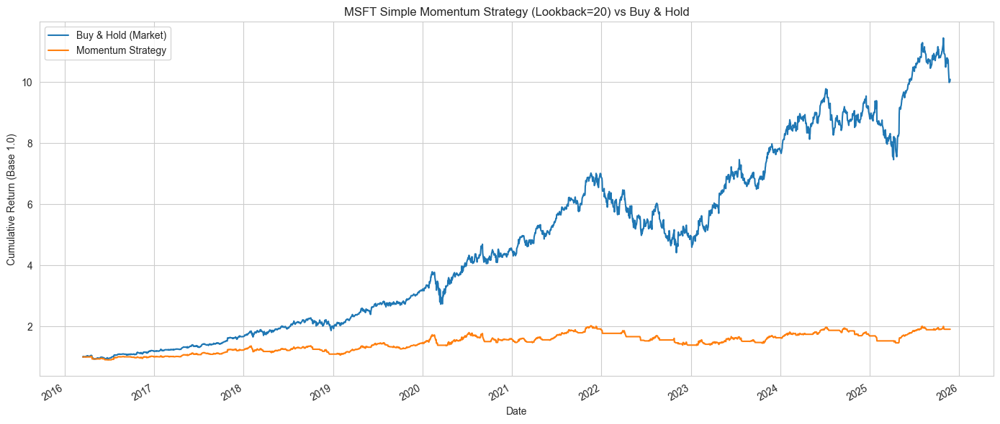

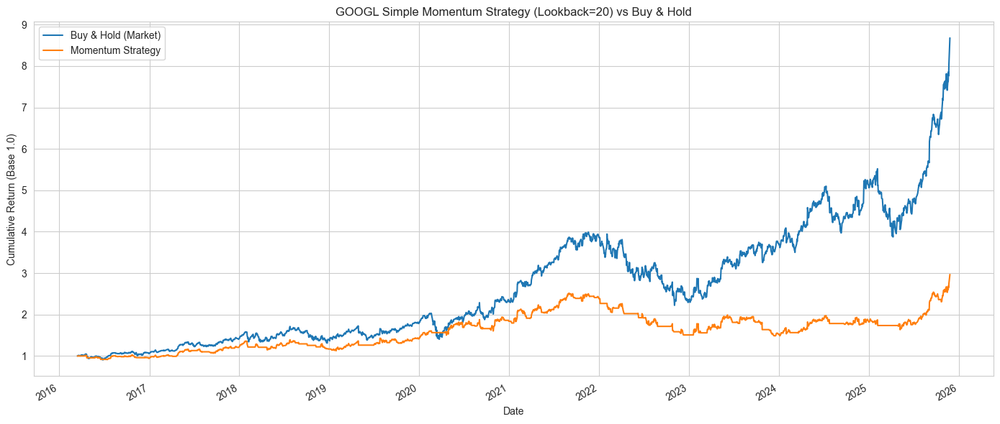

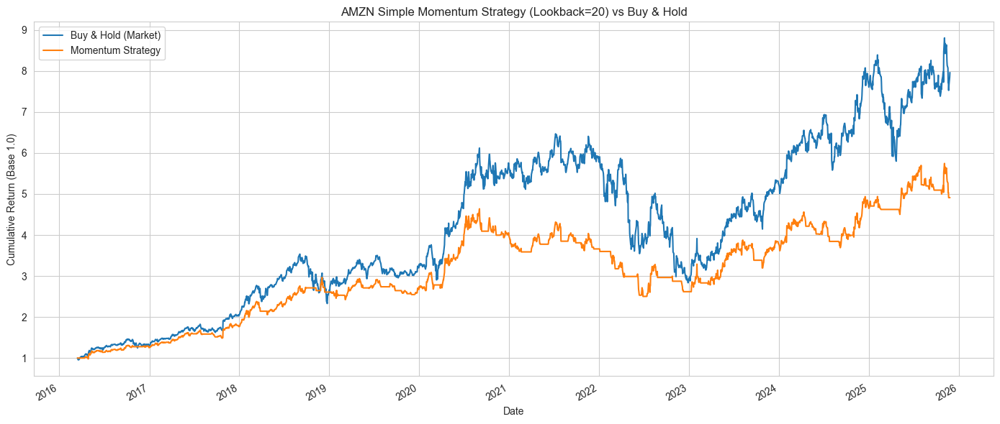

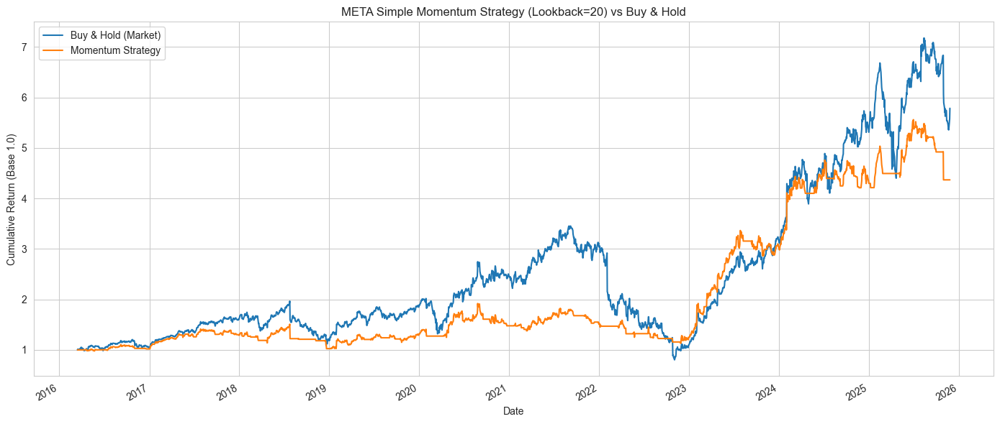

In [ ]:
def calculate_momentum_strategy(df, lookback=20, investment=100000):
    """Calculates a simple momentum strategy on adjusted close price returns."""
    
    strategy_df = df[['Adj Close']].copy()
    
    strategy_df['Signal'] = (strategy_df['Adj Close'].pct_change(lookback) > 0).astype(int) 
    
    strategy_df['Signal'] = strategy_df['Signal'].shift(1).fillna(0)
    strategy_df.dropna(inplace=True)

    strategy_df['Market_Return'] = strategy_df['Adj Close'].pct_change()
    
    strategy_df['Strategy_Return'] = strategy_df['Signal'] * strategy_df['Market_Return']

    strategy_df['Cumulative_Market'] = (1 + strategy_df['Market_Return']).cumprod().fillna(1)
    strategy_df['Cumulative_Strategy'] = (1 + strategy_df['Strategy_Return']).cumprod().fillna(1)

    return strategy_df

momentum_results_dict = {}
investment_amount = 100000
lookback_period = 20 # 1 month momentum

print("--- Running Simple Momentum Strategy (Buy/Hold vs. 20-Day Momentum) ---")

for ticker, df in df_features_dict.items():
    try:
        strategy_df = calculate_momentum_strategy(df, lookback=lookback_period, investment=investment_amount)
        momentum_results_dict[ticker] = strategy_df
        
        final_market = strategy_df['Cumulative_Market'].iloc[-1] * investment_amount
        final_strategy = strategy_df['Cumulative_Strategy'].iloc[-1] * investment_amount

        print(f"\n{ticker} Strategy Results:")
        print(f"Final Buy & Hold Value: ${final_market:,.2f}")
        print(f"Final Strategy Value: ${final_strategy:,.2f}")
        
    except Exception as e:
        print(f"Skipping {ticker} due to error: {e}")

print("\n--- Final Momentum Strategy Summary ---")
summary_data = []
for ticker, df in momentum_results_dict.items():
    final_market_value = df['Cumulative_Market'].iloc[-1] * investment_amount
    final_strategy_value = df['Cumulative_Strategy'].iloc[-1] * investment_amount
    summary_data.append({
        'Ticker': ticker,
        'Buy_Hold_Value': final_market_value,
        'Strategy_Value': final_strategy_value,
        'Return_Outperformance': (final_strategy_value / final_market_value) - 1
    })

summary_df = pd.DataFrame(summary_data).set_index('Ticker')
# Format monetary columns
summary_df['Buy_Hold_Value'] = summary_df['Buy_Hold_Value'].map('${:,.2f}'.format)
summary_df['Strategy_Value'] = summary_df['Strategy_Value'].map('${:,.2f}'.format)
summary_df['Return_Outperformance'] = summary_df['Return_Outperformance'].map('{:+.2%}'.format)
print(summary_df.to_string())

print("\n--- Generating Cumulative Return Plots ---")
for ticker, strategy_df in momentum_results_dict.items():
    fig, ax = plt.subplots(figsize=(14, 6))
    
    strategy_df[['Cumulative_Market', 'Cumulative_Strategy']].plot(ax=ax)
    
    ax.set_title(f'{ticker} Simple Momentum Strategy (Lookback={lookback_period}) vs Buy & Hold')
    ax.set_ylabel('Cumulative Return (Base 1.0)')
    ax.set_xlabel('Date')
    ax.grid(True)
    ax.legend(['Buy & Hold (Market)', 'Momentum Strategy'])
    plt.tight_layout()
    plt.show() # Display the plot
    plt.close(fig) # Close the figure to prevent accumulation/redundancy

### **8.2. Model-Driven Backtest with VectorBT**

**SARIMAX**

This code performs a **backtest of the SARIMAX price forecasts** across all tickers:

* It converts the SARIMAX **log-price forecasts back to actual prices**.
* It generates **trading signals**: *buy if the forecasted price is higher than the current price, otherwise stay out*.
* Using **vectorbt**, it simulates a portfolio based on these signals, including trading fees and initial capital.
* It calculates **portfolio performance statistics** such as total return, Sharpe ratio, and maximum drawdown for each stock.
* Finally, it summarizes the backtest results in a table for easy comparison.

The strategy in this backtest is a **forecast-driven momentum strategy** based on SARIMAX predictions:

* **Buy signal:** Enter a long position if the **SARIMAX forecasted price for the next day is higher than the current price**.
* **Exit signal:** Close the position (or stay out) if the forecast does not indicate an increase (i.e., predicted price ≤ current price).

Essentially, it **takes a position only when the model expects the price to rise**, holding cash otherwise. It’s a **systematic “buy if expected to go up” strategy** using the SARIMAX forecasts to guide entry and exit points.

In [ ]:
sarimax_backtest_stats = {}
forecast_series_name = 'SARIMAX_Forecast'

print(f"--- Starting Backtest for {forecast_series_name} across all tickers ---")

for ticker, log_predictions in sarimax_predictions_dict.items():
    try:
        print(f"\nProcessing {ticker}...")

        splits = data_splits_dict[ticker]
        df_full = splits['df_full']

        # Convert SARIMAX log-forecast -> price forecast
        # Ensure predictions are 1D
        price_predictions = np.exp(np.asarray(log_predictions).squeeze())

        if isinstance(log_predictions, pd.Series):
            aligned_index = log_predictions.index
        else:
            aligned_index = df_full.index[-len(price_predictions):]

        aligned_adj_close_series = df_full.loc[aligned_index, 'Adj Close'].squeeze()

        pred_series = pd.Series(price_predictions, index=aligned_index, name=forecast_series_name)

        aligned_adj_close_series, pred_series = aligned_adj_close_series.align(pred_series, join='inner', axis=0)

        # Create trading signals
        # Buy if predicted price > current price
        signals = pred_series > aligned_adj_close_series
        signals = signals.astype(bool)
        signals.name = 'Entry_Signal'

        # Entry = previous day's signal, Exit = opposite
        entries = signals.shift(1).fillna(False)
        exits = ~entries

        close = aligned_adj_close_series.iloc[1:]
        entries = entries.iloc[1:]
        exits = exits.iloc[1:]

        pf = vbt.Portfolio.from_signals(
            close=close,
            entries=entries,
            exits=exits,
            init_cash=100_000,
            fees=0.001,
            freq='D'
        )

        print(f"{ticker} Portfolio statistics:")
        stats = pf.stats()
        print(stats)
        sarimax_backtest_stats[ticker] = stats

    except Exception as e:
        print(f"Error during SARIMAX backtest for {ticker}: {e}")

print(f"\n--- SARIMAX Backtest Summary ---")
summary_data = []

for ticker, stats in sarimax_backtest_stats.items():
    summary_data.append({
        'Ticker': ticker,
        'Total Return [%]': stats.get('Total Return [%]'),
        'Sharpe Ratio': stats.get('Sharpe Ratio'),
        'Max Drawdown [%]': stats.get('Max Drawdown [%]'),
    })

if summary_data:
    summary_df = pd.DataFrame(summary_data).set_index('Ticker')
    print(summary_df.to_string())
else:
    print("No successful SARIMAX backtests to summarize.")

--- Starting Backtest for SARIMAX_Forecast across all tickers ---

Processing AAPL...
AAPL Portfolio statistics:
Start                               2023-12-18 00:00:00
End                                 2025-11-25 00:00:00
Period                                487 days 00:00:00
Start Value                                    100000.0
End Value                                 109971.410609
Total Return [%]                               9.971411
Benchmark Return [%]                          42.725855
Max Gross Exposure [%]                            100.0
Total Fees Paid                            14917.554464
Max Drawdown [%]                               22.03931
Max Drawdown Duration                 206 days 00:00:00
Total Trades                                         75
Total Closed Trades                                  75
Total Open Trades                                     0
Open Trade PnL                                      0.0
Win Rate [%]                                  5

**Pure GARCH trading strategy**

This section implements **two GARCH-based strategies** across all tickers:

1. **GARCH Volatility Regime Strategy**:
   * Uses **daily 1-step-ahead GARCH forecasts** of volatility.
   * Generates trading signals based on volatility level:
     * **Low volatility (below median):** take a long position.
     * **High volatility (above median):** stay out (flat).
   * Simulates a portfolio using these signals and calculates performance metrics such as total return, Sharpe ratio, and drawdown.
   * In short: Go long when predicted daily volatility is below the median, and stay out of the market when volatility is high.

2. **GARCH Volatility Targeting Strategy**:
   * Uses the same daily GARCH volatility forecasts.
   * Dynamically adjusts **position size** based on forecasted volatility:
     * Target a fixed daily volatility (e.g., 2%).
     * Reduce position size in high-volatility periods, increase in low-volatility periods, with a leverage cap.
   * Simulates a portfolio following these dynamic weights and calculates performance metrics.
   * In short: Dynamically adjust position size so that the portfolio targets a fixed daily volatility, taking smaller positions in high-volatility periods and larger positions in low-volatility periods.

We **use GARCH volatility forecasts either to enter/exit trades (regime strategy) or scale position size (targeting strategy)**, then backtests the resulting portfolios to evaluate performance.

In [20]:
def get_garch_walkforward_forecasts(df_full, forecast_index):
    """Generate daily 1-step-ahead GARCH volatility forecasts aligned to forecast_index."""
    returns = df_full["log_return"].dropna() * 100
    
    initial_train = returns.loc[:forecast_index[0]]
    
    garch = arch_model(initial_train, vol='Garch', p=1, q=1, rescale=True)
    fit = garch.fit(disp="off")

    rolling_returns = initial_train.copy()
    vol_forecasts = []

    for date in forecast_index:
        model = arch_model(rolling_returns, vol='Garch', p=1, q=1, rescale=True)
        fit = model.fit(disp="off")

        sigma = (fit.forecast(horizon=1).variance.iloc[-1, 0]**0.5) / 100
        
        vol_forecasts.append(sigma)

        if date in returns.index:
            rolling_returns.loc[date] = returns.loc[date]

    return pd.Series(vol_forecasts, index=forecast_index, name="GARCH_vol")

**Pure GARCH Strategy #1: Volatility Regime Filter**

Trade only during low volatility

In [ ]:
garch_regime_stats = {}

print("\n--- Running PURE GARCH Volatility Regime Strategy ---")

for ticker, df in df_features_dict.items():
    try:
        df_full = df
        close = df_full["Adj Close"]

        # Use SARIMAX test index for consistency
        forecast_index = sarimax_predictions_dict[ticker].index
        
        # Daily 1-step GARCH forecasts
        garch_vol = get_garch_walkforward_forecasts(df_full, forecast_index)

        # Threshold = median volatility
        threshold = garch_vol.median()

        # Low volatility → long, high volatility → flat
        signal = (garch_vol < threshold).astype(bool)

        entries = signal.shift(1).fillna(False)
        exits = ~entries

        close_bt = close.loc[forecast_index][1:]
        entries = entries.iloc[1:]
        exits = exits.iloc[1:]

        pf = vbt.Portfolio.from_signals(
            close=close_bt,
            entries=entries,
            exits=exits,
            init_cash=100000,
            fees=0.001,
            freq='D'
        )

        stats = pf.stats()
        garch_regime_stats[ticker] = stats
        
        print(f"\n{ticker} GARCH Regime Stats:")
        print(stats)

    except Exception as e:
        print(f"Error in GARCH regime strategy for {ticker}: {e}")


--- Running PURE GARCH Volatility Regime Strategy ---

AAPL GARCH Regime Stats:
Start                         2023-12-18 00:00:00
End                           2025-11-25 00:00:00
Period                          487 days 00:00:00
Start Value                              100000.0
End Value                            87663.781479
Total Return [%]                       -12.336219
Benchmark Return [%]                    42.725855
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4945.840498
Max Drawdown [%]                         25.70121
Max Drawdown Duration           485 days 00:00:00
Total Trades                                 29.0
Total Closed Trades                          28.0
Total Open Trades                             1.0
Open Trade PnL                        2504.158646
Win Rate [%]                            42.857143
Best Trade [%]                           13.57367
Worst Trade [%]                        -10.799199
Avg Winning Trade [

**Pure GARCH Strategy #2: Volatility Targeting**

Position size = ``target_vol / forecast_vol``

In [ ]:
garch_target_stats = {}
target_vol = 0.02  # 2% desired daily vol

print("\n--- Running PURE GARCH Volatility Targeting Strategy ---")

for ticker, df in df_features_dict.items():
    try:
        df_full = df
        close = df_full["Adj Close"]
        forecast_index = sarimax_predictions_dict[ticker].index

        garch_vol = get_garch_walkforward_forecasts(df_full, forecast_index)

        # Position weight = target_vol / forecast_vol
        weights = (target_vol / garch_vol).clip(0, 3)   # cap leverage
        weights = weights.shift(1).fillna(0)

        close_bt = close.loc[forecast_index]

        pf = vbt.Portfolio.from_orders(
            close=close_bt,
            size=weights,
            size_type='targetpercent',
            init_cash=100000,
            fees=0.001,
            freq='D'
        )

        stats = pf.stats()
        garch_target_stats[ticker] = stats
        
        print(f"\n{ticker} GARCH Targeting Stats:")
        print(stats)

    except Exception as e:
        print(f"Error in GARCH targeting for {ticker}: {e}")


--- Running PURE GARCH Volatility Targeting Strategy ---

AAPL GARCH Targeting Stats:
Start                                 2023-12-15 00:00:00
End                                   2025-11-25 00:00:00
Period                                  488 days 00:00:00
Start Value                                      100000.0
End Value                                   132150.551539
Total Return [%]                                32.150552
Benchmark Return [%]                            41.512206
Max Gross Exposure [%]                              100.0
Total Fees Paid                                 563.30539
Max Drawdown [%]                                31.910072
Max Drawdown Duration                   229 days 00:00:00
Total Trades                                         27.0
Total Closed Trades                                  26.0
Total Open Trades                                     1.0
Open Trade PnL                               30605.000813
Win Rate [%]                               

**Hybrid SARIMAX + GARCH VectorBT Backtest**

This hybrid strategy combines two complementary models:

1. **SARIMAX** → Forecasts the expected next-day log price (mean prediction).
2. **GARCH** → Forecasts the volatility of that return (risk/variance prediction).

The trading signal is **long only when SARIMAX predicts an upward move AND GARCH forecasts low volatility**, effectively blending **directional confidence with risk control**. This approach captures upward trends while avoiding high-volatility periods, reducing the risk of large drawdowns. Conceptually, it is a **return-weighted, risk-filtered strategy**, leveraging the strengths of both models: SARIMAX captures trend and mean behavior, while GARCH captures time-varying risk.

This classical econometric combination is widely used in:

* Equity derivatives pricing
* Volatility-targeted strategies
* Regime detection
* Risk-managed directional trading

In [ ]:
hybrid_backtest_stats = {}
hybrid_series_name = "SARIMAX_GARCH_Hybrid"

print(f"--- Starting HYBRID Backtest ({hybrid_series_name}) ---")

for ticker, log_preds in sarimax_predictions_dict.items():
    try:
        print(f"\nProcessing {ticker}...")

        # Convert SARIMAX log forecast → price
        sarimax_price_pred = pd.Series(np.exp(np.asarray(log_preds).squeeze()),
                                       index=log_preds.index, name="SARIMAX_Price")

        df_full = data_splits_dict[ticker]["df_full"]
        actual_price = df_full.loc[sarimax_price_pred.index, "Adj Close"].squeeze()

        # Fit GARCH on returns BEFORE forecast window
        full_log = np.log(df_full["Adj Close"])
        returns = full_log.diff().dropna()

        # Use only training period (up to first forecast date)
        train_returns = returns.loc[:sarimax_price_pred.index[0]]

        garch_vol_forecasts = []

        rolling_returns = train_returns.copy()

        for date in sarimax_price_pred.index:
            model = arch_model(rolling_returns, p=1, q=1)
            fit = model.fit(update_freq=0, disp="off")
            sigma = np.sqrt(fit.forecast(horizon=1).variance.values[-1, 0])
            garch_vol_forecasts.append(sigma)

            # Add realized return for next iteration
            if date in returns.index:
                rolling_returns.loc[date] = returns.loc[date]

        garch_vol_forecasts = pd.Series(garch_vol_forecasts,
                                        index=sarimax_price_pred.index,
                                        name="GARCH_vol")

        sarimax_price_pred, actual_price, garch_vol_forecasts = sarimax_price_pred.align(
            actual_price, join="inner"
        )[0], sarimax_price_pred.align(actual_price, join="inner")[1], garch_vol_forecasts.align(actual_price, join="inner")[0]

        # Hybrid signal
        # Buy if SARIMAX predicts up AND volatility is below median
        vol_threshold = garch_vol_forecasts.median()

        sarimax_signal = sarimax_price_pred > actual_price
        vol_filter = garch_vol_forecasts < vol_threshold

        hybrid_signal = (sarimax_signal & vol_filter).astype(bool)

        # Lookahead-safe entries
        entries = hybrid_signal.shift(1).fillna(False)
        exits = ~entries

        close = actual_price.iloc[1:]
        entries = entries.iloc[1:]
        exits = exits.iloc[1:]

        pf = vbt.Portfolio.from_signals(
            close=close,
            entries=entries,
            exits=exits,
            init_cash=100000,
            fees=0.001,
            freq="D"
        )

        stats = pf.stats()
        hybrid_backtest_stats[ticker] = stats
        print(stats)

    except Exception as e:
        print(f"Hybrid backtest failed for {ticker}: {e}")

if hybrid_backtest_stats:
    summary_df = pd.DataFrame({
        t: {
            "Total Return [%]": s.get("Total Return [%]"),
            "Sharpe Ratio": s.get("Sharpe Ratio"),
            "Max Drawdown [%]": s.get("Max Drawdown [%]")
        }
        for t, s in hybrid_backtest_stats.items()
    }).T
    print("\n--- Hybrid SARIMAX + GARCH Summary ---")
    print(summary_df.to_string())
else:
    print("No successful hybrid backtests to summarize.")

--- Starting HYBRID Backtest (SARIMAX_GARCH_Hybrid) ---

Processing AAPL...
Start                               2023-12-18 00:00:00
End                                 2025-11-25 00:00:00
Period                                487 days 00:00:00
Start Value                                    100000.0
End Value                                  94666.803248
Total Return [%]                              -5.333197
Benchmark Return [%]                          42.725855
Max Gross Exposure [%]                            100.0
Total Fees Paid                             8515.590879
Max Drawdown [%]                              17.861459
Max Drawdown Duration                 461 days 00:00:00
Total Trades                                         46
Total Closed Trades                                  46
Total Open Trades                                     0
Open Trade PnL                                      0.0
Win Rate [%]                                  54.347826
Best Trade [%]              

**Hybrid SARIMAX + GARCH Vol-Targeted Strategy**

A SARIMAX directional model combined with GARCH volatility scaling is essentially what many macro & CTA hedge funds do.

This strategy combines **SARIMAX directional forecasts** with **GARCH-based volatility targeting** to manage both expected return and risk:

1. **SARIMAX** → Provides a directional signal by predicting whether the next-day price will rise.
2. **GARCH** → Forecasts daily volatility, used to scale position sizes dynamically.

The trading approach:

* Take a long position only if SARIMAX predicts an upward move.
* Adjust the **position size proportionally to a target volatility** (e.g., 2% daily), reducing exposure in high-volatility periods and increasing it in low-volatility periods.
* Leverage is capped to avoid excessive risk.

This results in a **risk-managed directional strategy** that combines trend-following with volatility-based position sizing. It aims to **capture upward moves while keeping portfolio volatility close to the desired target**, providing smoother performance and controlled drawdowns compared with a pure directional strategy.

In [ ]:
hybrid_vol_target_stats = {}
target_vol = 0.02  # Target 2% daily volatility

print("\n--- Running Hybrid Vol-Targeted SARIMAX Strategy ---")

for ticker, df in df_features_dict.items():
    try:
        df_full = df.copy()
        close = df_full["Adj Close"]

        sarimax_forecast = sarimax_predictions_dict[ticker]

        if sarimax_forecast.name != "SARIMAX_Price_Forecast":
            sarimax_price_forecast = np.exp(sarimax_forecast)
        else:
            sarimax_price_forecast = sarimax_forecast

        actual_price = close.loc[sarimax_price_forecast.index]
        if isinstance(actual_price, pd.DataFrame):
            actual_price = actual_price.squeeze()  # Fix 2D -> 1D

        # SARIMAX directional signal (1 if price predicted higher, else 0)
        signal = (sarimax_price_forecast > actual_price).astype(int)
        signal = signal.shift(1).fillna(0)  # Lookahead-safe

        garch_vol = get_garch_walkforward_forecasts(df_full, sarimax_forecast.index)
        if isinstance(garch_vol, pd.DataFrame):
            garch_vol = garch_vol.squeeze()  # Ensure 1D

        # Position sizing: signal * target_vol / forecast_vol
        hybrid_weight = (signal * (target_vol / garch_vol)).clip(0, 3)

        close_bt = close.loc[sarimax_price_forecast.index]

        pf = vbt.Portfolio.from_orders(
            close=close_bt,
            size=hybrid_weight,
            size_type='targetpercent',
            init_cash=100_000,
            fees=0.001,
            freq='D'
        )

        stats = pf.stats()
        hybrid_vol_target_stats[ticker] = stats

        print(f"\n{ticker} Hybrid SARIMAX + GARCH Vol-Targeted Stats:")
        print(stats)

    except Exception as e:
        print(f"Error in hybrid vol-target SARIMAX strategy for {ticker}: {e}")

summary_df = pd.DataFrame({
    t: {
        "Total Return [%]": s.get("Total Return [%]"),
        "Sharpe Ratio": s.get("Sharpe Ratio"),
        "Max Drawdown [%]": s.get("Max Drawdown [%]")
    }
    for t, s in hybrid_vol_target_stats.items()
}).T

print("\n--- Hybrid Vol-Targeted SARIMAX Summary ---")
print(summary_df.to_string())


--- Running Hybrid Vol-Targeted SARIMAX Strategy ---

AAPL Hybrid SARIMAX + GARCH Vol-Targeted Stats:
Start                               2023-12-15 00:00:00
End                                 2025-11-25 00:00:00
Period                                488 days 00:00:00
Start Value                                    100000.0
End Value                                  108065.33168
Total Return [%]                               8.065332
Benchmark Return [%]                          41.512206
Max Gross Exposure [%]                            100.0
Total Fees Paid                            14641.310205
Max Drawdown [%]                              18.263665
Max Drawdown Duration                 217 days 00:00:00
Total Trades                                       86.0
Total Closed Trades                                86.0
Total Open Trades                                   0.0
Open Trade PnL                                      0.0
Win Rate [%]                                  48.837209
B

**Comparison**

In [33]:
comparison_table = []

for ticker in df_features_dict.keys():
    comparison_table.append({
        "Ticker": ticker,
        "SARIMAX_Return": sarimax_backtest_stats.get(ticker, {}).get("Total Return [%]"),
        "Hybrid_Return": hybrid_backtest_stats.get(ticker, {}).get("Total Return [%]"),
        "GARCH_Regime_Return": garch_regime_stats.get(ticker, {}).get("Total Return [%]"),
        "GARCH_Target_Return": garch_target_stats.get(ticker, {}).get("Total Return [%]"),
        "Hybrid_Vol_Target_Return": hybrid_vol_target_stats.get(ticker, {}).get("Total Return [%]")
    })

comparison_df = pd.DataFrame(comparison_table).set_index("Ticker")

print("\n--- Strategy Comparison Table (% Return) ---")
print(comparison_df.to_string())


--- Strategy Comparison Table (% Return) ---
        SARIMAX_Return  Hybrid_Return  GARCH_Regime_Return  GARCH_Target_Return  Hybrid_Vol_Target_Return
Ticker                                                                                                   
AAPL          9.971411      -5.333197           -12.336219            32.150552                  8.065332
MSFT         -2.777511       0.921688             6.659101            27.597791                 -3.425288
GOOGL        53.387748      15.980234            67.936048           128.402862                 50.949633
AMZN         17.909016      -5.588490            -6.323807            38.435707                  8.833172
META         27.496070      20.593627            33.784516            71.888770                 24.693296


---

## **9. Conclusion**

### **1. Pure SARIMAX**

| Ticker | SARIMAX Return (%) |
| ------ | ------------------ |
| AAPL   | 9.97               |
| MSFT   | -2.78              |
| GOOGL  | 53.39              |
| AMZN   | 17.91              |
| META   | 27.50              |

* SARIMAX does reasonably well for GOOGL, META, and AMZN, but struggles for MSFT.
* SARIMAX is purely a directional **price-forecasting model**; it doesn’t account for volatility or regime shifts, so it can be very sensitive to sudden market moves.

### **2. Hybrid SARIMAX + GARCH Regime Filter**

| Ticker | Hybrid Return (%) |
| ------ | ----------------- |
| AAPL   | -5.33             |
| MSFT   | 0.92              |
| GOOGL  | 15.98             |
| AMZN   | -5.59             |
| META   | 20.59             |

* Adding a volatility filter reduces exposure in high-volatility periods.
* On some tickers (AAPL, AMZN), the filter was too conservative — it missed profitable moves, leading to negative returns.
* On META, it helped reduce risk and capture trends, so the return is positive but smaller than pure SARIMAX.

### **3. Pure GARCH Strategies**

* **GARCH Regime (simple filter based on volatility spikes)**
  * Performs poorly for some tickers (AAPL -12.3%), but extremely well for GOOGL (67.9%).
  * Works when the market is volatile and mean-reverting.

* **GARCH Vol Targeting**
  * Much stronger returns on most tickers (MSFT 27.6%, GOOGL 128.4%, META 71.9%).
  * This strategy scales position sizes by forecasted volatility: when risk is high, reduce exposure; when risk is low, increase exposure.
  * Shows the **power of risk-adjusted sizing** — it captures more upside while controlling drawdown.

### **4. Hybrid Vol-Targeted SARIMAX**

| Ticker | Hybrid Vol-Target Return (%) |
| ------ | ---------------------------- |
| AAPL   | 8.07                         |
| MSFT   | -3.43                        |
| GOOGL  | 50.95                        |
| AMZN   | 8.83                         |
| META   | 24.69                        |

* This combines directional SARIMAX signals with GARCH volatility scaling.
* Works best when SARIMAX predictions are reasonably accurate (GOOGL, META).
* Still struggles when SARIMAX is less predictive (MSFT, AAPL).
* Draws a middle ground between pure SARIMAX and pure GARCH vol-targeted.

### **Overall Insights**

1. **Pure SARIMAX** is good for trending assets where its prediction accuracy is strong, but it ignores volatility.
2. **Hybrid SARIMAX + simple GARCH filter** is too conservative on some tickers; it avoids losses but often misses gains.
3. **Pure GARCH Vol-Targeting** often delivers the **highest risk-adjusted returns**, especially in assets with predictable volatility clustering.
4. **Hybrid Vol-Targeted SARIMAX** gives **moderate returns**, improving downside protection without being as aggressive as pure GARCH vol-targeting.

**Key takeaway:**

* For consistent performance across multiple tickers, **GARCH vol-targeting is the most robust**.
* SARIMAX helps **add directional alpha**, but only when its predictions are reliable.
* Combining SARIMAX with GARCH volatility control is **worth it for selective tickers**, but a naive hybrid filter can sometimes reduce returns if SARIMAX signals are noisy.